<a href="https://colab.research.google.com/github/duchaba/Data-Augmentation-with-Python/blob/main/data_augmentation_with_python_chapter_7_with_output.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🌻 Welcome to Chapter 7, Audio Data Augmentation

---

I am glad to see you using this Python Notebook. 🐕

The Python Notebook is an integral part of the book. You can add new “code cells” to extend the functions, add your data, and explore new possibilities, such as downloading additional real-world datasets from the Kaggle website and coding the **Fun challenges**. Furthermore, the book has **Fun facts**, in-depth discussion about augmentation techniques, and Pluto, an imaginary Siberian Huskey coding companion. Together they will guide you every steps of the way. 

Pluto encourages you to copy or save a copy of this Python Notebook to your local space and add the “text cells” to keep your notes. In other words, read the book and copy the relevant concept to this Python Notebook’s text-cells. Thus, you can have the explanation, note, original code, your code, and any crazy future ideas in one place.  


💗 I hope you enjoy reading the book and hacking code as much as I enjoy writing it. 


## 🌟 Amazon Book

---

- The book is available on the Amazon Book website: 
  - https://www.amazon.com/dp/1803246456

  - Author: Duc Haba
  - Published: 2023
  - Page count: 390+


- The original Python Notebook is on: 
  - https://github.com/PacktPublishing/Data-Augmentation-with-Python/blob/main/Chapter_7/data_augmentation_with_python_chapter_7.ipynb 

- 🚀 Click on the blue "Open in Colab" button at the top of this page to begin hacking.


# 😀 Excerpt from Chapter 7, Audio Data Augmentation

---

> In case you haven’t bought the book. Here is an teaser from the first page of Chapter 7.

---

Similar to image and text augmentation, the objective of audio data augmentation is to extend the dataset to gain a higher accuracy forecast or prediction in a generative AI system. Audio augmentation is cost-effective and is a viable option when acquiring additional audio files is expensive or time-consuming.  

Writing about audio augmentation methods poses unique challenges. The first is that audio is not visual like images or text. If the format is audiobooks, web pages, or mobile apps, then we play the sound, but the medium is paper. Thus, we must transform the audio signal into a visual representation. The Waveform graph, also known as the time series graph, is a standard method for representing an audio signal. You can listen to the audio in the accompanying Python Notebook. 

In this chapter, you will learn how to write Python code to read an audio file and draw a Waveform graph from scratch. Pluto has provided a preview here so that we can discuss the components of the Waveform graph. The function is as follows: 

> ...skip...image...

In Figure 7.1, Pluto drew the positive amplitude in blue and the negative amplitude in yellow in the Waveform graph. This makes the chart easier to read and prettier. The amplitude is the value of the Y-axis. It measures the vibration or compression and decompression of the air molecules. The higher the amplitude, the greater the air displacement. In other words, the zero amplitude value is silent, and the greater the absolute distance from zero, the louder the sound. 

The frequency, also known as the sampling rate, is the value of the X-axis. The sampling rate measures how many times you recorded the amplitude value in a second. The unit for sound frequency or the sampling rate is hertz (Hz). For example, a sampling rate of 1,000 Hz or 1 kilohertz (kHz) means you record a thousand amplitude values in 1 second. In other words, you register an amplitude value for every millisecond. Thus, the higher the frequency, the more accurate the sound, and therefore, a larger sound file size. This is because there is a higher recorded amplitude value. 1 kHz is equal to 1,000 Hz.

Pitch is the same as frequency but from a human point of view. It refers to the loudness of the sound and is measured in decibels (dB). Thus, high pitch means high frequency. 

dB is the unit for the degree of loudness. A rocket sound is about 165 dB, busy traffic noise is about 85 dB, human speech is about 65 dB, rainfall is about 45 dB, and zero dB means silence. 

The standard sampling rate for MP3 and other audio formats is 22.05 kHz. The frequency of high-quality sound, also known as Compact Disk (CD) sound, is 44.1 kHz. 

When storing an audio file on a computer, bit depth is the accuracy of the amplitude value. 16 bits has 65,536 levels of detail, while 24 bits has 16,777,216 levels of information. The higher the bit depth, the closer the digital recording is to the analog sound and the larger the audio file size.  

The bit rate is similar to the sampling rate, where the bit rate measures the number of bits per second. In audio processing, the playback function uses the bit rate, while the record function uses the sampling rate. 

Mono sound has one channel (1-channel), while stereo sound has two channels (2-channel). Stereo sound has one channel for the right ear and another channel for the left ear. 

> ...skip...skip...

This chapter will cover audio augmentation using Waveform transformation, and in particular, the following topics:   

- Standard audio augmentation techniques 

- Filters 

- Audio augmentation libraries 

- Real-world audio datasets  

- Reinforcing your learning through Python Notebook

Let’s begin by discussing common audio augmentation methods. 

---

🌴 *end of excerpt from the book*

# Load Notebook


- This Notebook original link is: 
  - https://github.com/PacktPublishing/Data-Augmentation-with-Python/blob/main/data_augmentation_with_python_chapter_7.ipynb

# GitHub Clone

In [1]:
# git version should be 2.17.1 or higher
!git --version

git version 2.25.1


In [2]:
url = 'https://github.com/PacktPublishing/Data-Augmentation-with-Python'
!git clone {url}

Cloning into 'Data-Augmentation-with-Python'...
remote: Enumerating objects: 162, done.
remote: Counting objects: 100% (140/140), done.
remote: Compressing objects: 100% (92/92), done.
remote: Total 162 (delta 73), reused 107 (delta 47), pack-reused 22
Receiving objects: 100% (162/162), 13.24 MiB | 13.59 MiB/s, done.
Resolving deltas: 100% (73/73), done.


## Fetch file from URL (Optional)

- Uncommend the below 2 code cells if you want to use URL and not Git Clone

In [3]:
# import requests
# #
# def fetch_file(url, dst):
#   downloaded_obj = requests.get(url)
#   with open(dst, "wb") as file:
#     file.write(downloaded_obj.content)
#   return

In [4]:
# url = ''
# dst = 'pluto_chapter_1.py'
# fetch_file(url,dst)

# Run Pluto

- Instantiate up Pluto, aka. "Pluto, wake up!"

In [5]:
# %% CARRY-OVER code install

!pip install opendatasets 
!pip install pyspellchecker 

# The tested version:
# opendatasets==0.1.12
# pyspellchecker==0.7.1
#
# if error with newer version, then install:
# !pip install opendatasets==0.1.12 
# !pip install pyspellchecker==0.7.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 24.2 MB/s eta 0:00:00


In [6]:
#load and run the pluto chapter 1 Python code.
pluto_file = 'Data-Augmentation-with-Python/pluto/pluto_chapter_2.py'
%run {pluto_file}

---------------------------- : ----------------------------
            Hello from class : <class '__main__.PacktDataAug'> Class: PacktDataAug
                   Code name : Pluto
                   Author is : Duc Haba
---------------------------- : ----------------------------


## Verify Pluto

In [7]:
pluto.say_sys_info()

---------------------------- : ----------------------------
                 System time : 2023/04/26 22:15
                    Platform : linux
     Pluto Version (Chapter) : 2.0
             Python (3.7.10) : actual: 3.9.16 (main, Dec  7 2022, 01:11:51) [GCC 9.4.0]
            PyTorch (1.11.0) : actual: 2.0.0+cu118
              Pandas (1.3.5) : actual: 1.5.3
                 PIL (9.0.0) : actual: 8.4.0
          Matplotlib (3.2.2) : actual: 3.7.1
                   CPU count : 2
                   CPU speed : 2.20 GHz
               CPU max speed : 0.00 GHz
---------------------------- : ----------------------------


## (Optional) Export to .py

In [8]:
pluto_chapter_7 = 'Data-Augmentation-with-Python/pluto/pluto_chapter_7.py'
!cp {pluto_file} {pluto_chapter_7}

# ✋ Set up Kaggle username and app Key

- Install the following libraries, and import it on the Notebook.
- Follow by initialize Kaggle username, key and fetch methods.

- STOP: Update your Kaggle access username or key first.

In [9]:
# %%CARRY-OVER code 

# -------------------- : --------------------
# READ ME
# Chapter 2 begin:
# Install the following libraries, and import it on the Notebook.
# Follow by initialize Kaggle username, key and fetch methods.
# STOP: Update your Kaggle access username or key first.
# -------------------- : --------------------

!pip install opendatasets --upgrade
import opendatasets
print("\nrequired version 0.1.22 or higher: ", opendatasets.__version__)

!pip install pyspellchecker 
import spellchecker
print("\nRequired version 0.7+", spellchecker.__version__)

# STOP: Update your Kaggle access username or key first.
pluto.remember_kaggle_access_keys("YOUR-USERNAME", "YOUR-KEY")
pluto._write_kaggle_credit()
import kaggle

@add_method(PacktDataAug)
def fetch_kaggle_comp_data(self,cname):
  #self._write_kaggle_credit()  # need to run only once.
  path = pathlib.Path(cname)
  kaggle.api.competition_download_cli(str(path))
  zipfile.ZipFile(f'{path}.zip').extractall(path)
  return

@add_method(PacktDataAug)
def fetch_kaggle_dataset(self,url,dest="kaggle"):
  #self._write_kaggle_credit()    # need to run only once.
  opendatasets.download(url,data_dir=dest)
  return
# -------------------- : --------------------


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

required version 0.1.22 or higher:  0.1.22
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

Required version 0.7+ 0.7.2


# Fetch Kaggle Data

## Musical Emotions Classification

In [10]:
%%time
url = 'https://www.kaggle.com/datasets/kingofarmy/musical-emotions-classification'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 641M/641M [00:07<00:00, 85.1MB/s]



CPU times: user 7.48 s, sys: 3.12 s, total: 10.6 s
Wall time: 18.5 s


In [11]:
f = 'kaggle/musical-emotions-classification/Train.csv'
pluto.df_music_data = pluto.fetch_df(f)
pluto.df_music_data.head(3)

,GroupID,ImageID,Target,Shapes
0,Happy102,Happy10200.wav,Happy,220608
1,Happy102,Happy10201.wav,Happy,220608
2,Happy102,Happy10202.wav,Happy,220608


In [12]:
# %%writefile -a {pluto_chapter_7}

pluto.version = 7.0
# augment full path
@add_method(PacktDataAug)
def _append_music_full_path(self,x):
  y = re.findall('([a-zA-Z ]*)\d*.*', x)[0]
  return (f'kaggle/musical-emotions-classification/Audio_Files/Audio_Files/Train/{y}/{x}')
#
@add_method(PacktDataAug)
def fetch_music_full_path(self, df):
  df['fname'] = df.ImageID.apply(self._append_music_full_path)
  return df

In [13]:
pluto.fetch_music_full_path(pluto.df_music_data)
pluto.df_music_data.head(3)

,GroupID,ImageID,Target,Shapes,fname
0,Happy102,Happy10200.wav,Happy,220608,kaggle/musical-emotions-classification/Audio_F...
1,Happy102,Happy10201.wav,Happy,220608,kaggle/musical-emotions-classification/Audio_F...
2,Happy102,Happy10202.wav,Happy,220608,kaggle/musical-emotions-classification/Audio_F...


## Human Speech

In [14]:
%%time
url = 'https://www.kaggle.com/datasets/ejlok1/cremad'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 451M/451M [00:04<00:00, 102MB/s] 



CPU times: user 8.68 s, sys: 2.8 s, total: 11.5 s
Wall time: 17.7 s


In [15]:
# 
# change method name to make_dir_dframe
f = 'kaggle/cremad/AudioWAV'
pluto.df_voice_data = pluto.make_dir_dataframe(f)
pluto.df_voice_data.head(3)

,fname,label
0,kaggle/cremad/AudioWAV/1040_IEO_FEA_MD.wav,AudioWAV
1,kaggle/cremad/AudioWAV/1071_IEO_ANG_LO.wav,AudioWAV
2,kaggle/cremad/AudioWAV/1022_IOM_SAD_XX.wav,AudioWAV


## Urban sound

In [16]:
%%time
url = 'https://www.kaggle.com/datasets/rupakroy/urban-sound-8k'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 5.61G/5.61G [01:00<00:00, 99.7MB/s]



CPU times: user 1min 14s, sys: 27.3 s, total: 1min 41s
Wall time: 2min 28s


In [17]:
# 
# change method name to make_dir_dframe
f = 'kaggle/urban-sound-8k/UrbanSound8K/UrbanSound8K/audio'
pluto.df_sound_data = pluto.make_dir_dataframe(f)
pluto.df_sound_data.head(3)

,fname,label
0,kaggle/urban-sound-8k/UrbanSound8K/UrbanSound8...,fold10
1,kaggle/urban-sound-8k/UrbanSound8K/UrbanSound8...,fold10
2,kaggle/urban-sound-8k/UrbanSound8K/UrbanSound8...,fold10


# View and Listen

In [18]:
# to-do: there is a deprecated function with version 0.10.0 (Feb. 2023)
!pip install librosa==0.9.2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.3/214.3 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 53.0 MB/s eta 0:00:00
  Attempting uninstall: librosa
    Found existing installation: librosa 0.10.0.post2
    Uninstalling librosa-0.10.0.post2:
      Successfully uninstalled librosa-0.10.0.post2


In [19]:
# %%writefile -a {pluto_chapter_7}

import IPython
import IPython.display
import librosa
import librosa.display
import matplotlib
import pandas
import numpy
import re

In [20]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def _draw_area_with_neg(self,ndata,pic,tcolor='#007bff',bcolor='#ffc107',alpha=0.75,istart=0,izero=0):
  nlen = len(ndata)
  i = numpy.arange(istart, istart+nlen)
  xzero = numpy.zeros(nlen)
  xzero += izero
  # plot line
  pic.plot(i,ndata, linewidth=0.0)  # invisible line for shading
  pic.plot(i,xzero,color='gray',linewidth=0.5) # base line

  # fill top/positive section
  pic.fill_between(
    i, xzero, ndata, where=(ndata >= xzero), 
    interpolate=True, color=tcolor, alpha=alpha, 
    label="Positive"
  )
  # fill bottom/negative section
  pic.fill_between(
    i, xzero, ndata, where=(ndata < xzero), 
    interpolate=True, color=bcolor, alpha=alpha, 
    label="Negative"
  )
  return
#
@add_method(PacktDataAug)
def _fetch_audio_data(self,lname):
  # select random record
  # samp = df.sample(xsize)
  # samp.reset_index(drop=True, inplace=True)
  data_amp, sam_rate = librosa.load(lname, mono=True)
  fname = re.findall('[^\/]+$', lname)
  return data_amp, sam_rate, fname[0]
#
@add_method(PacktDataAug)
def _draw_audio(self,data_amp, sam_rate, fname):
  # define constant
  zlen = 100
  nrow = 2
  ncol = 1
  w = 11
  h = 6
  title = ['', 'Zoom In: From Midpoint to 100+']
  ylabel = ['Waveform Amplitude']
  #
  # define graph
  canvas, pic = matplotlib.pyplot.subplots(nrow, ncol, figsize=(w, h))
  pics = pic.flatten()
  # draw original
  dlen = len(data_amp)
  self._draw_area_with_neg(data_amp,pic[0])
  pics[0].set_title(f'{title[0]} {fname}', fontsize=18.)
  pics[0].set_xlabel(f'Second: Total {dlen/sam_rate:.2f} sec., Sampling Rate: {sam_rate/1000:.2f} kHz', fontsize=16.)
  pics[0].set_ylabel(ylabel[0])
  #
  # overide tick with time
  loc = numpy.array(pics[0].get_xticks())
  b = loc / sam_rate
  b = numpy.round(b,1)
  pics[0].set_xticklabels(b)
  pics[0].grid()
  #
  # draw zoom
  mid = int(len(data_amp) / 2)
  end = mid + zlen
  self._draw_area_with_neg(data_amp[mid:end],pic[1])
  pics[1].set_title(title[1],fontsize=18.)
  pics[1].set_xlabel(f'Time Series Index: Midpoint at {mid/sam_rate:.2f} sec. ({mid} ts)', fontsize=16.)
  pics[1].set_ylabel(ylabel[0])
  pics[1].grid()
  # 
  # display and save image
  canvas.tight_layout()
  self._drop_image(canvas)
  canvas.show()
  # 
  return 
#
@add_method(PacktDataAug)
def draw_audio(self,df,id_name=None):
  # random take a file name
  if (id_name is None):
    samp = df.sample(1)
    samp.reset_index(drop=True, inplace=True)
    in_file = samp.fname[0]
  else:
    in_file = id_name
  #
  data_amp, sam_rate, fname = self._fetch_audio_data(in_file)
  self._draw_audio(data_amp, sam_rate, 'Original: ' + fname)
  # display audio 
  display(IPython.display.Audio(data_amp,rate=sam_rate))
  return
#

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)
/usr/local/lib/python3.9/dist-packages/IPython/lib/display.py:174: RuntimeWarning: invalid value encountered in true_divide
  scaled = data / normalization_factor * 32767


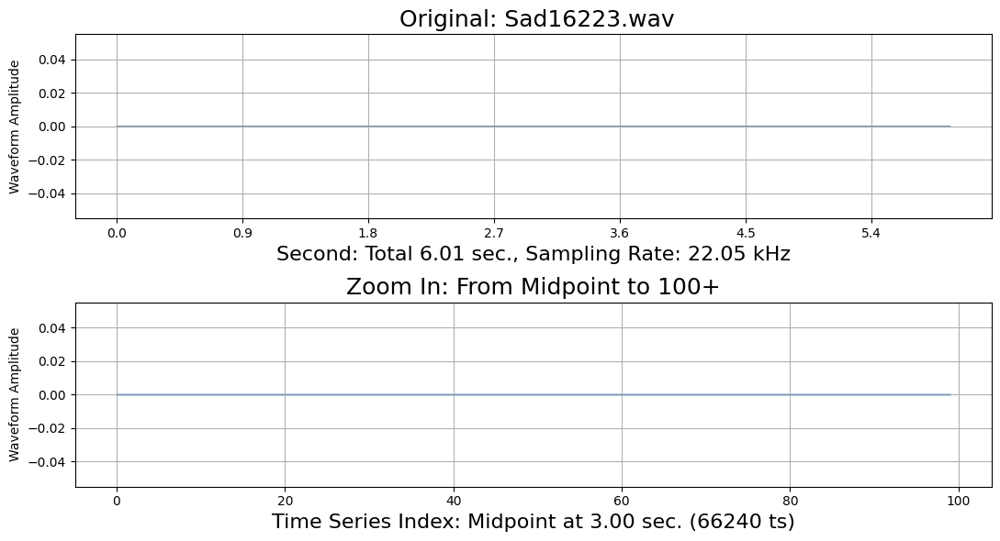

In [21]:
pluto.draw_audio(pluto.df_music_data)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


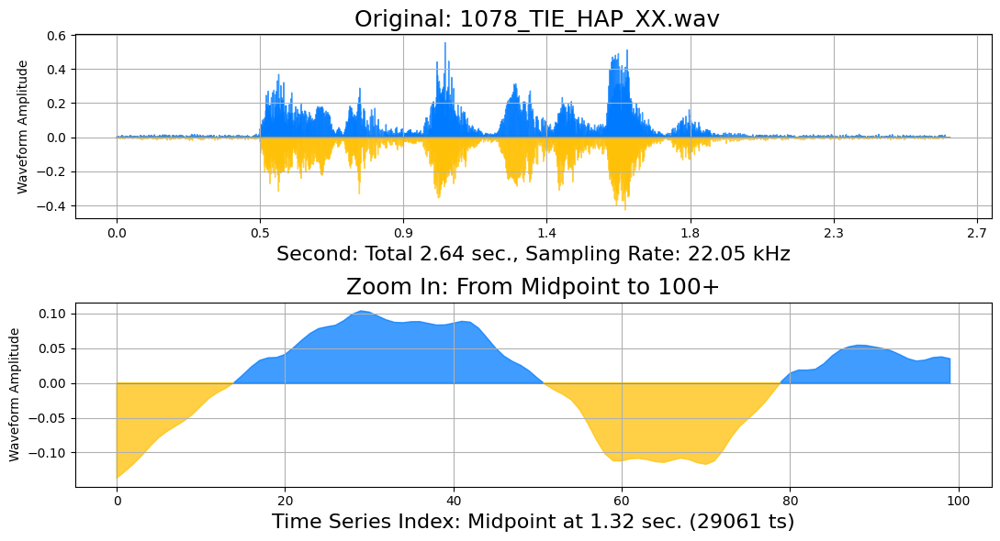

In [22]:
pluto.draw_audio(pluto.df_voice_data)

# Audio Control D-scale 

- pitches D, E, F♯, G, A, B, and C♯

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


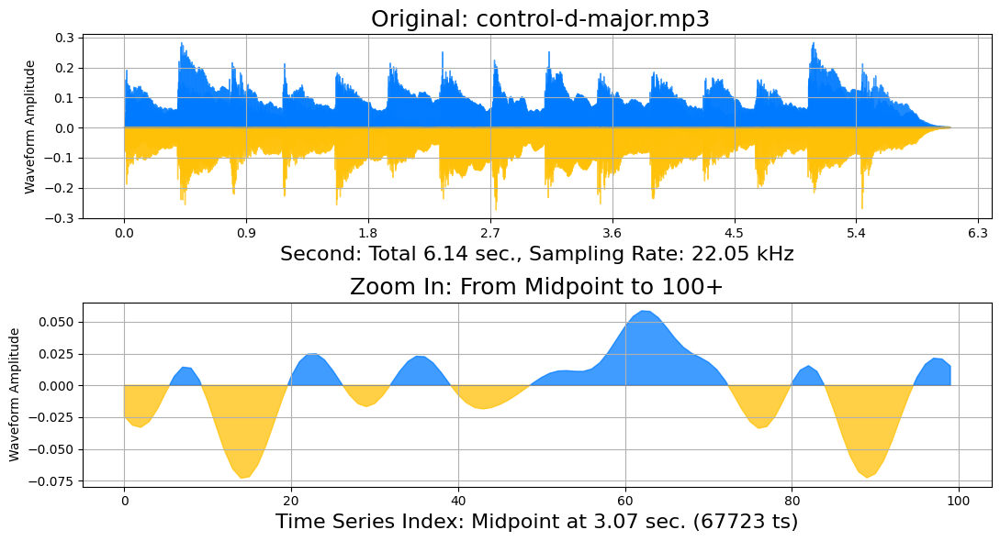

In [25]:
# 
f = 'Data-Augmentation-with-Python/pluto_data/control-d-major.mp3'
data_amp, sam_rate, fname = pluto._fetch_audio_data(f)
pluto.audio_control_dmajor = [data_amp, sam_rate, fname, f]
pluto._draw_audio(data_amp, sam_rate, 'Original: ' + fname)
# display audio 
display(IPython.display.Audio(data_amp, rate=sam_rate))

# Time shift

In [26]:
# %CARRY-OVER

!pip install audiomentations
#
# tested with version 0.29.0
# !pip install audiomentations==0.29.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.1/66.1 kB 3.0 MB/s eta 0:00:00


In [27]:
# %%writefile -a {pluto_chapter_7}

import audiomentations
#
@add_method(PacktDataAug)
def _fetch_1_sample(self, df, dsize=1):
  p = df.sample(dsize)
  p.reset_index(drop=True, inplace=True)
  return p.fname[0]
#
@add_method(PacktDataAug)
def _audio_transform(self, df, xtransform, title=''):
  if (type(df) is list):
    data_amp, sam_rate, fname, lname = self.audio_control_dmajor
  else:
    lname = self._fetch_1_sample(df)
    data_amp, sam_rate, fname = self._fetch_audio_data(lname)
  #
  xaug = xtransform(data_amp, sample_rate=sam_rate)
  # augmented
  self._draw_audio(xaug, sam_rate, title + ' Augmented: ' + fname)
  display(IPython.display.Audio(xaug, rate=sam_rate))
  # original
  self._draw_audio(data_amp, sam_rate, 'Original: ' + fname)
  display(IPython.display.Audio(data_amp, rate=sam_rate))
  return

In [28]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_time_shift(self, df, 
  min_fraction=-0.2,
  max_fraction=0.8,
  rollover=True,
  title='Time Shift',
  id_name=None):
  xtransform = audiomentations.Shift(
    min_fraction = min_fraction,
    max_fraction = max_fraction,
    rollover = rollover,
    p=1.0
  )
  self._audio_transform(df, xtransform, title=title)
  return

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


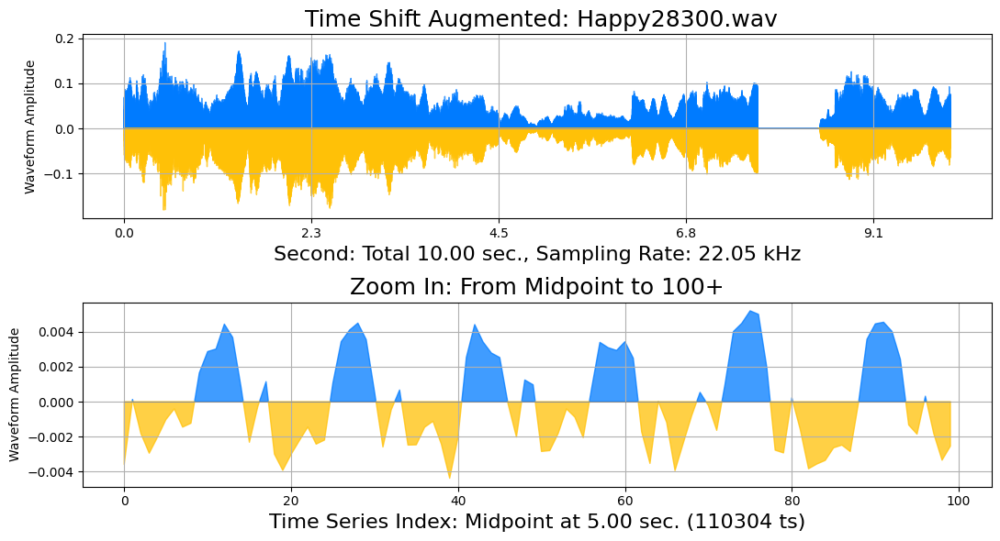

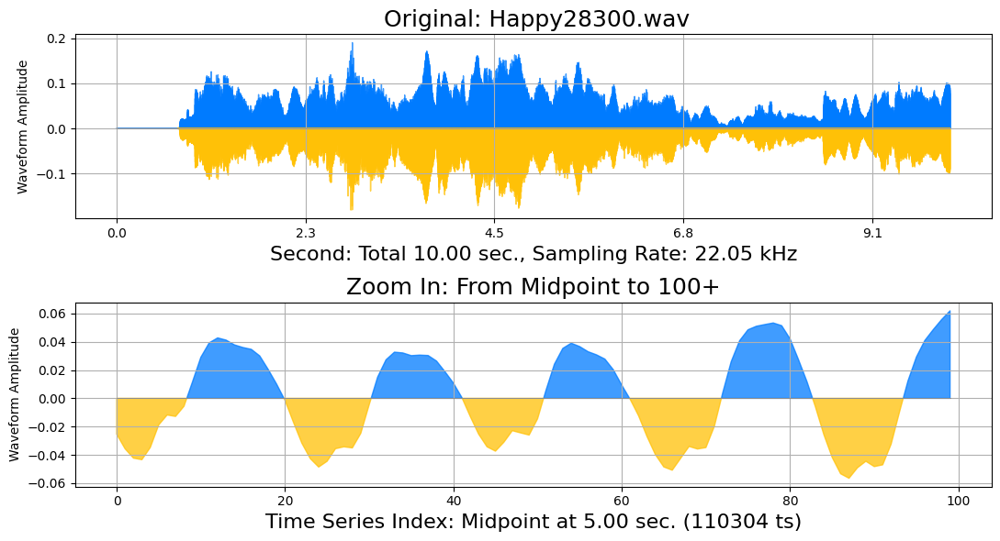

In [29]:
pluto.play_aug_time_shift(pluto.df_music_data, min_fraction=0.5)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


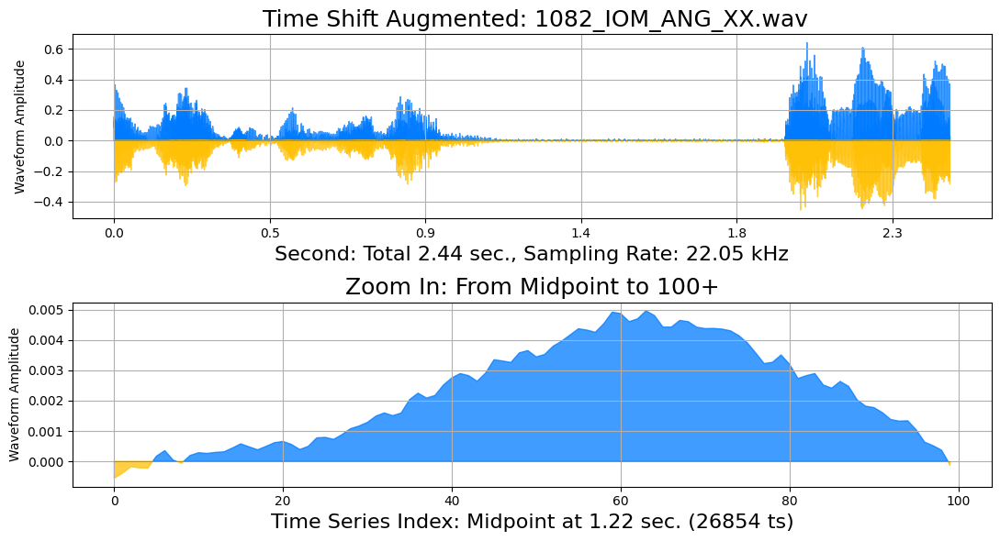

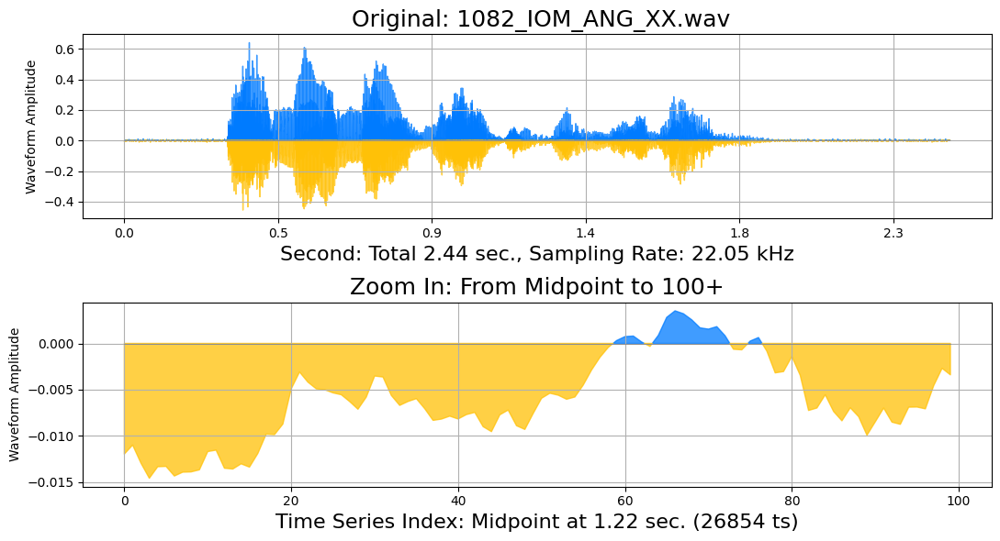

In [30]:
pluto.play_aug_time_shift(pluto.df_voice_data, min_fraction=0.5)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


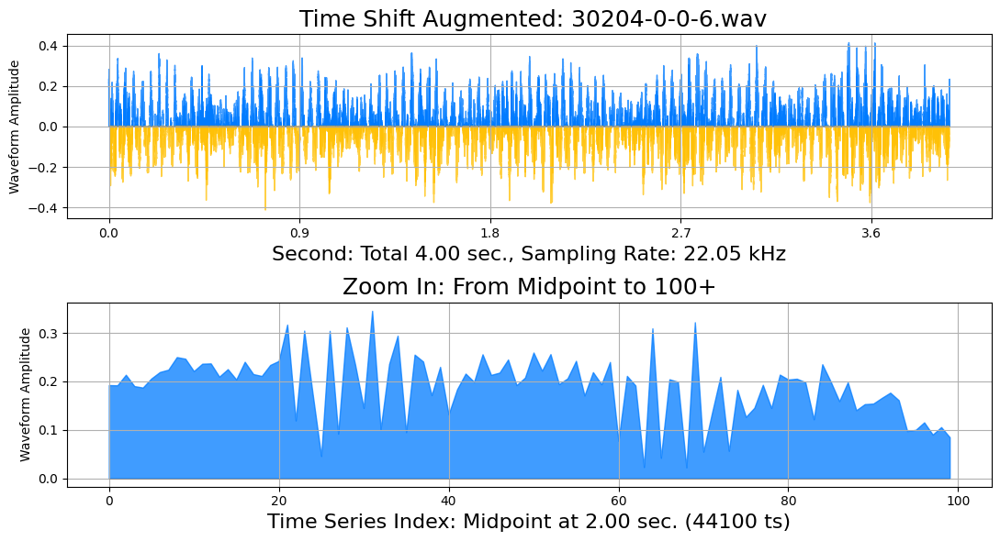

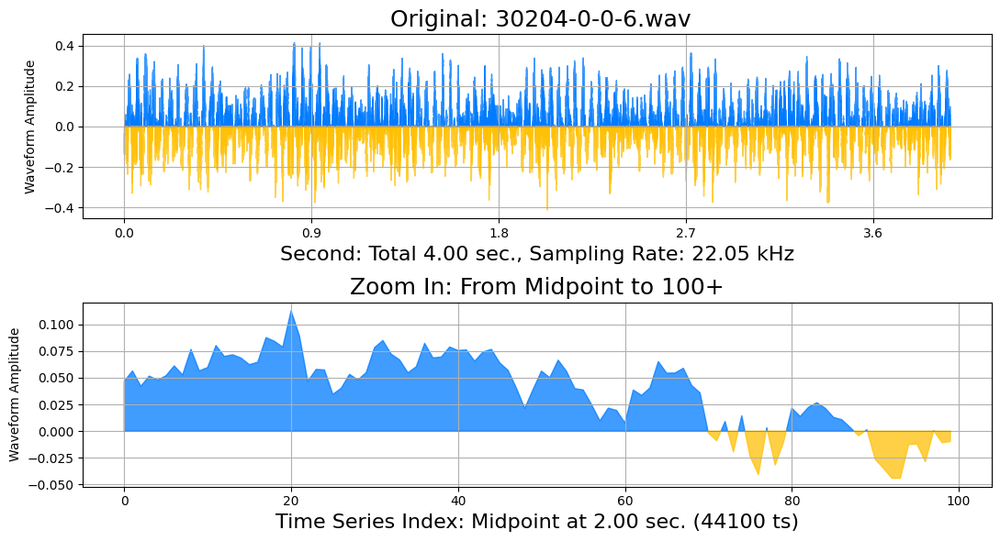

In [31]:
pluto.play_aug_time_shift(pluto.df_sound_data, min_fraction=0.5)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


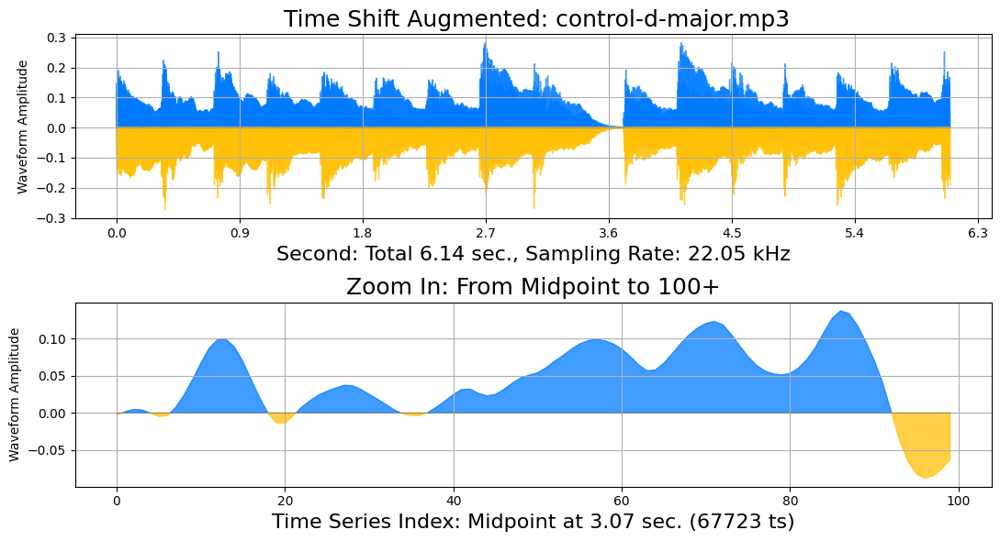

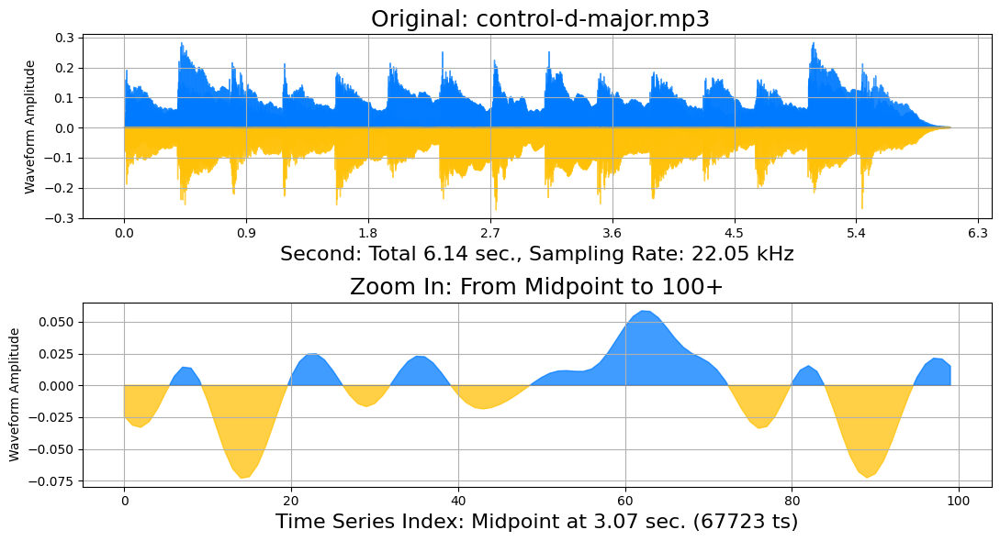

In [32]:
pluto.play_aug_time_shift(pluto.audio_control_dmajor, min_fraction=0.2)

# Time stretch

In [33]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_time_stretch(self, df, min_rate=0.2,max_rate=6.8,leave_length_unchanged=True,title='Time Stretch'):
  xtransform = audiomentations.TimeStretch(
    min_rate = min_rate,
    max_rate = max_rate,
    leave_length_unchanged = leave_length_unchanged,
    p=1.0
  )
  self._audio_transform(df, xtransform, title=title)
  return
  # librosa.effects.time_stretch under the hood 

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


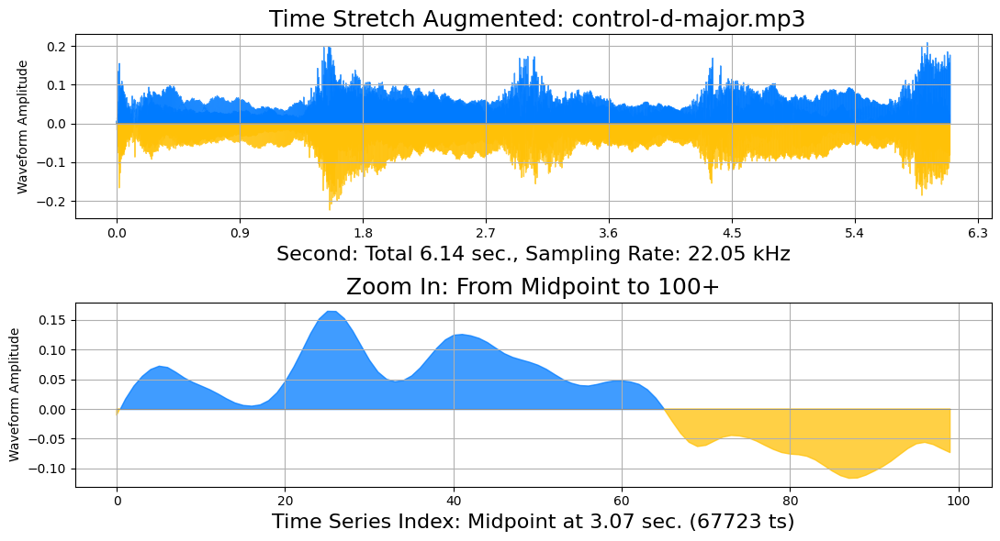

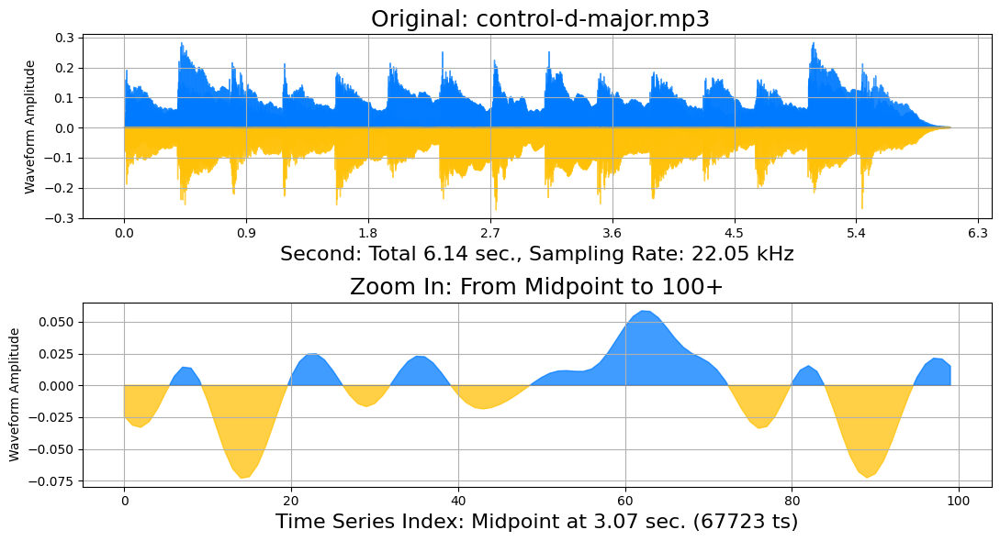

In [34]:
pluto.play_aug_time_stretch(pluto.audio_control_dmajor, max_rate=5.4)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


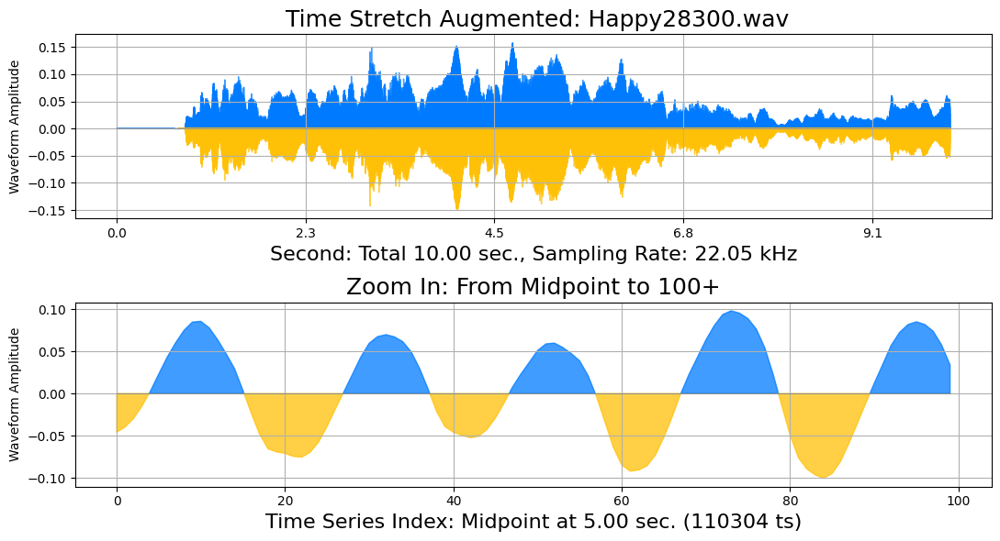

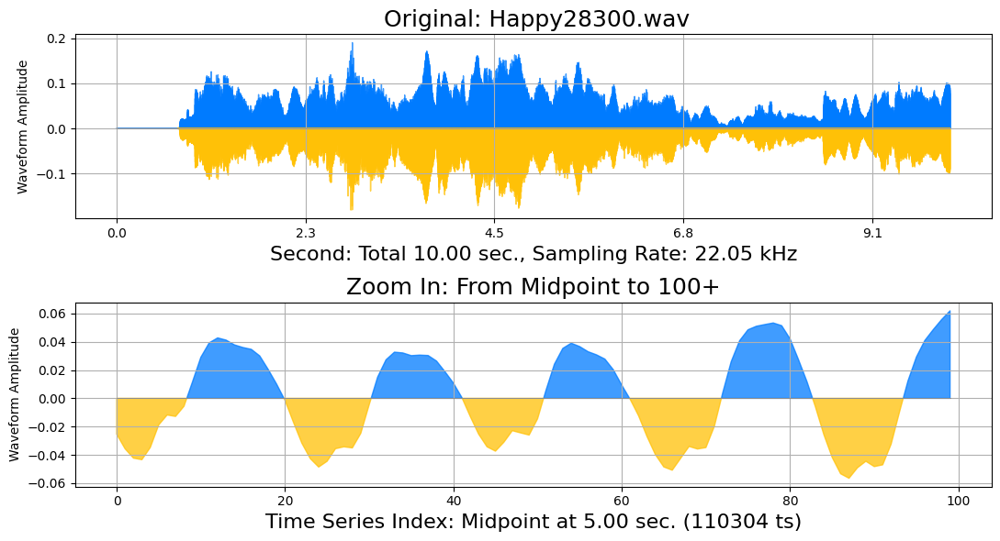

In [35]:
pluto.play_aug_time_stretch(pluto.df_music_data, max_rate=3.0)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


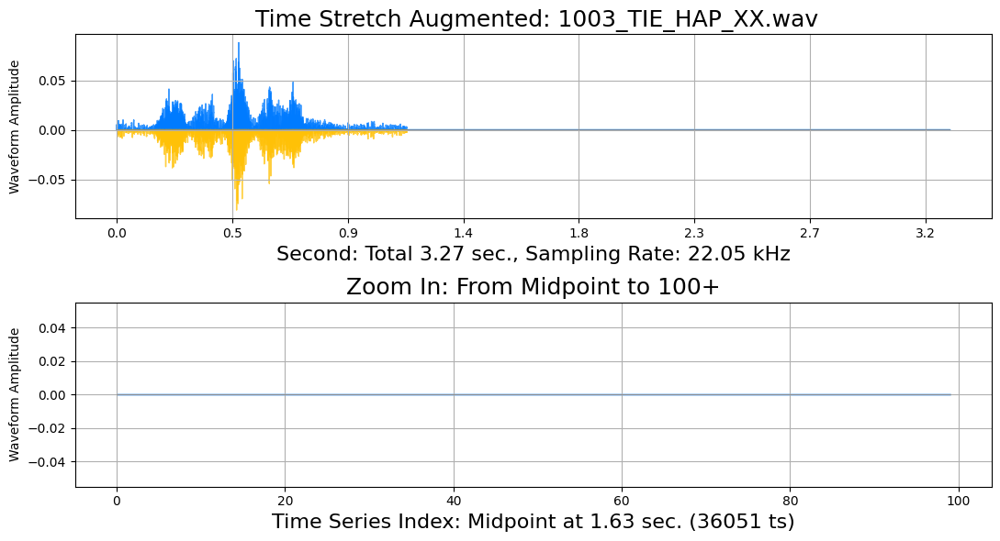

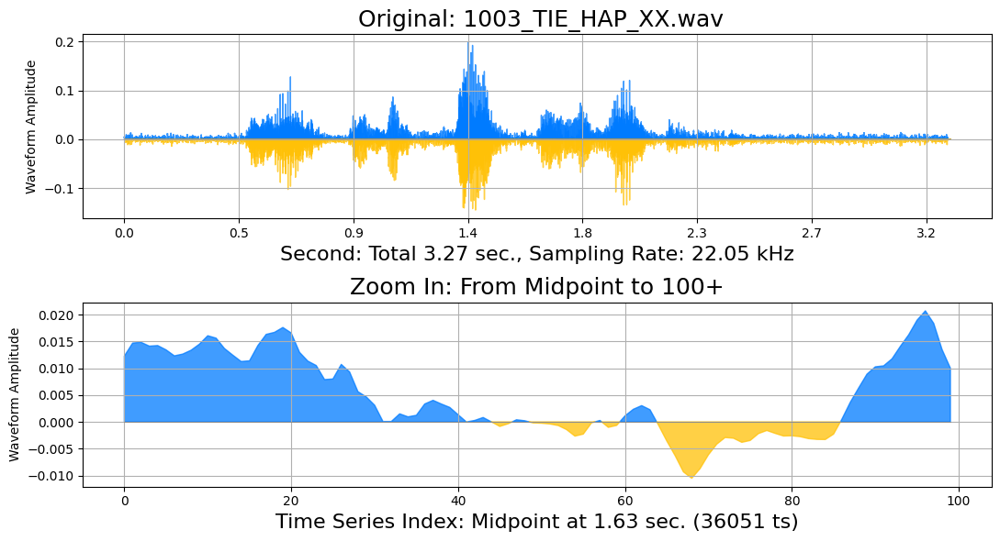

In [36]:
pluto.play_aug_time_stretch(pluto.df_voice_data, max_rate=3.5)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


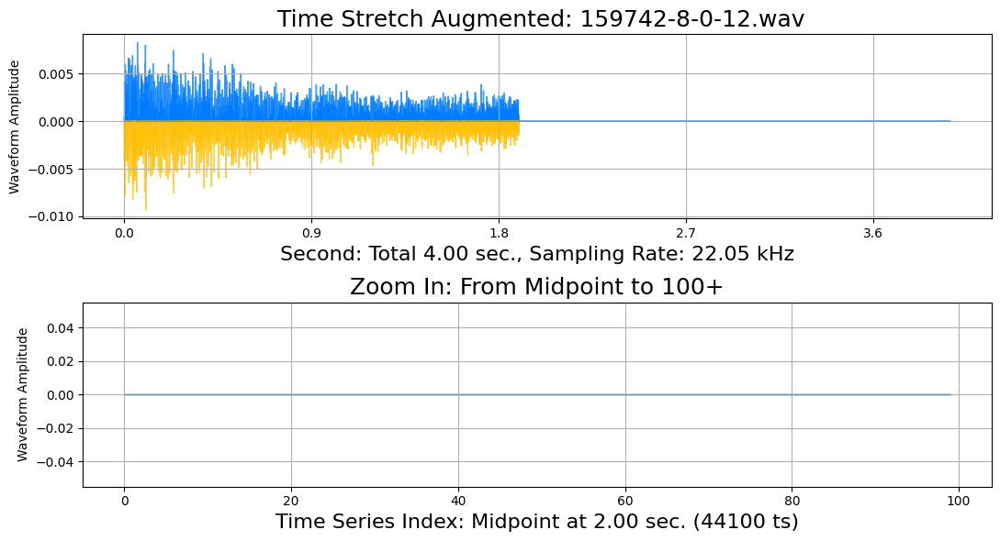

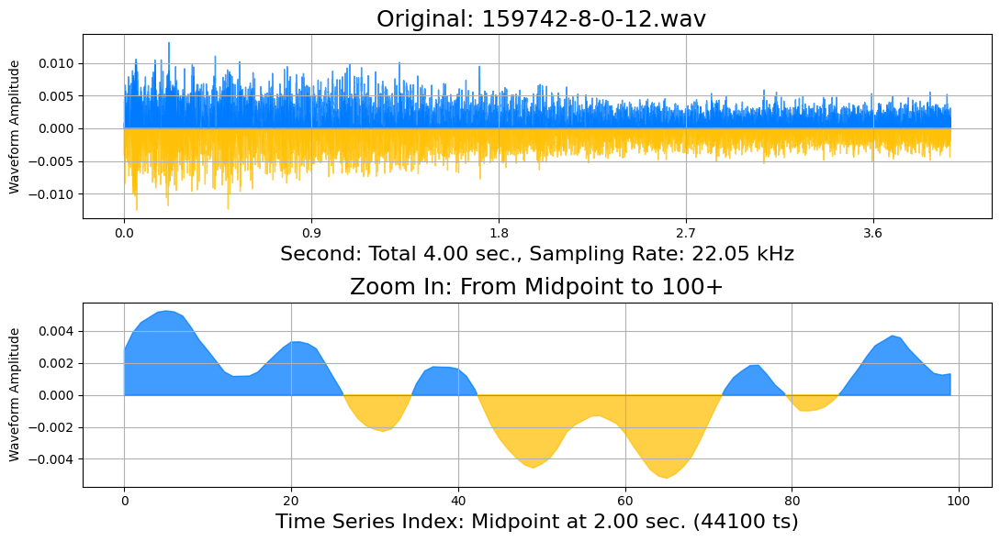

In [37]:
pluto.play_aug_time_stretch(pluto.df_sound_data, max_rate=2.5)

In [38]:
# pluto.fname_id

# Pitch scaling

In [39]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_pitch_scaling(self, df, min_semitones=-6.0,max_semitones=6.0,title='Pitch Scaling'):
  xtransform = audiomentations.PitchShift(
    min_semitones = min_semitones,
    max_semitones = max_semitones,
    p=1.0)
  self._audio_transform(df, xtransform, title=title)
  return

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


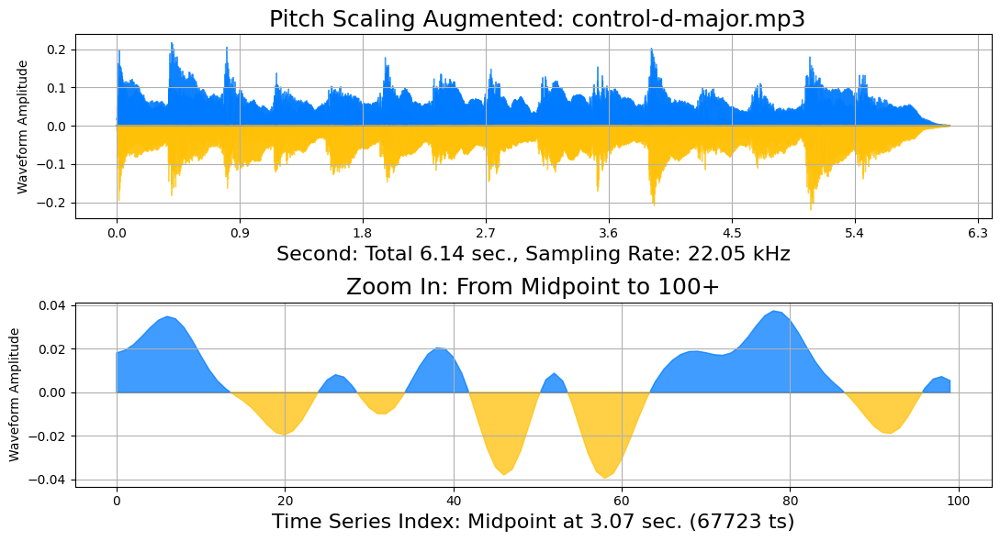

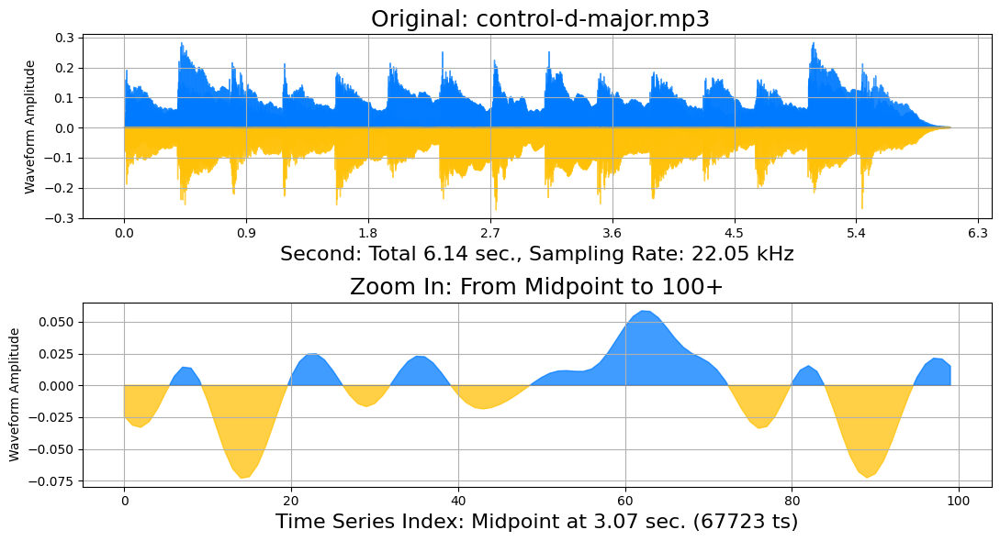

In [40]:
pluto.play_aug_pitch_scaling(pluto.audio_control_dmajor,min_semitones=-6.0,max_semitones=6.0)

In [41]:
# pluto.fname_id

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


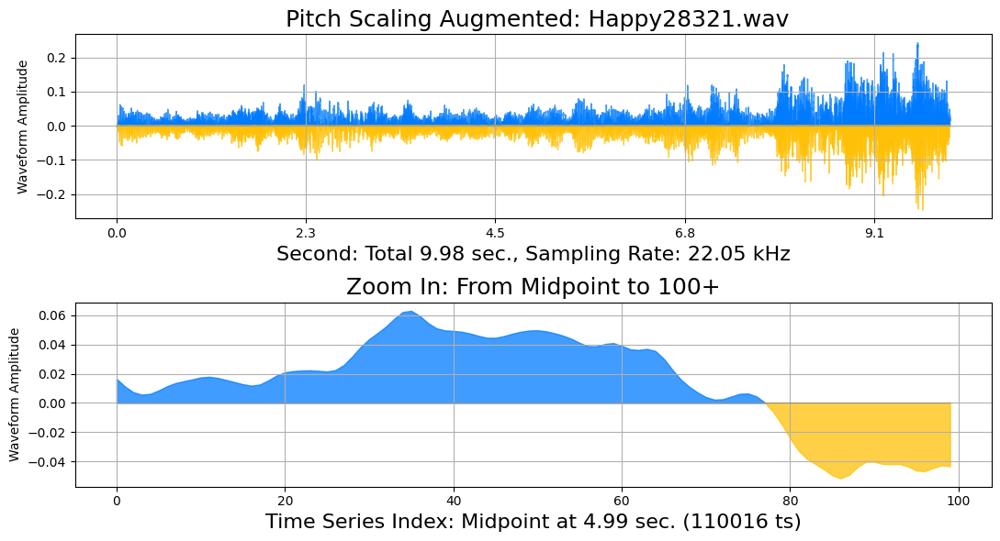

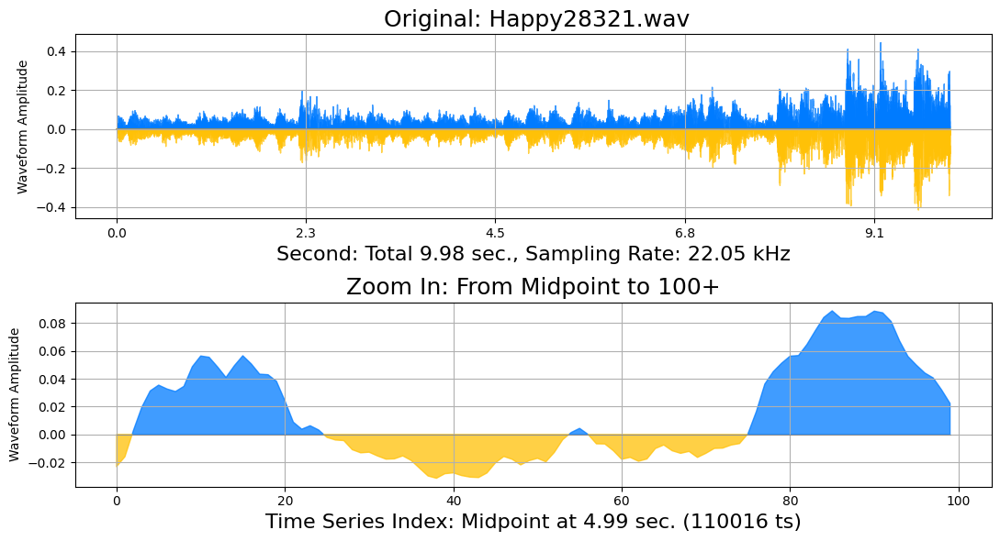

In [42]:
pluto.play_aug_pitch_scaling(pluto.df_music_data,min_semitones=-11.0, max_semitones=-9.0)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


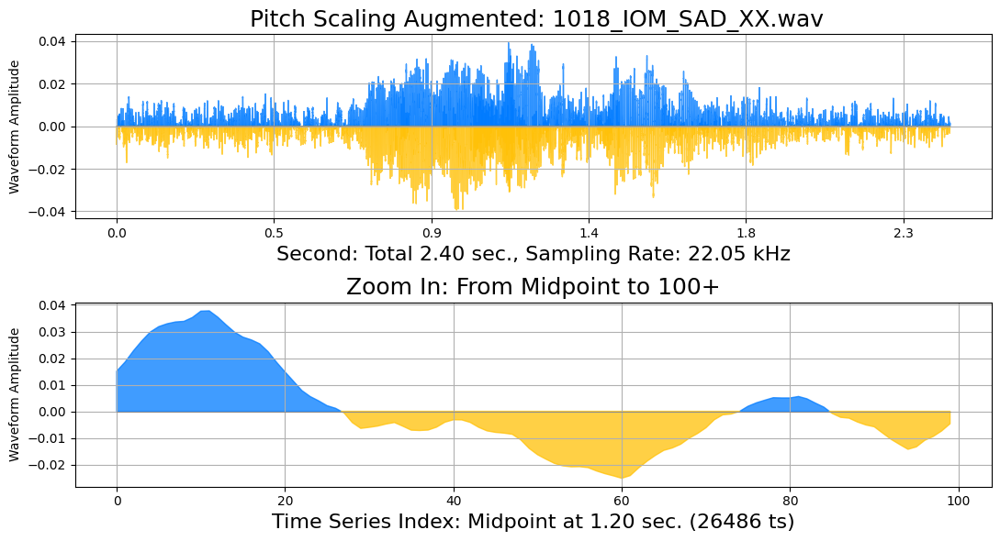

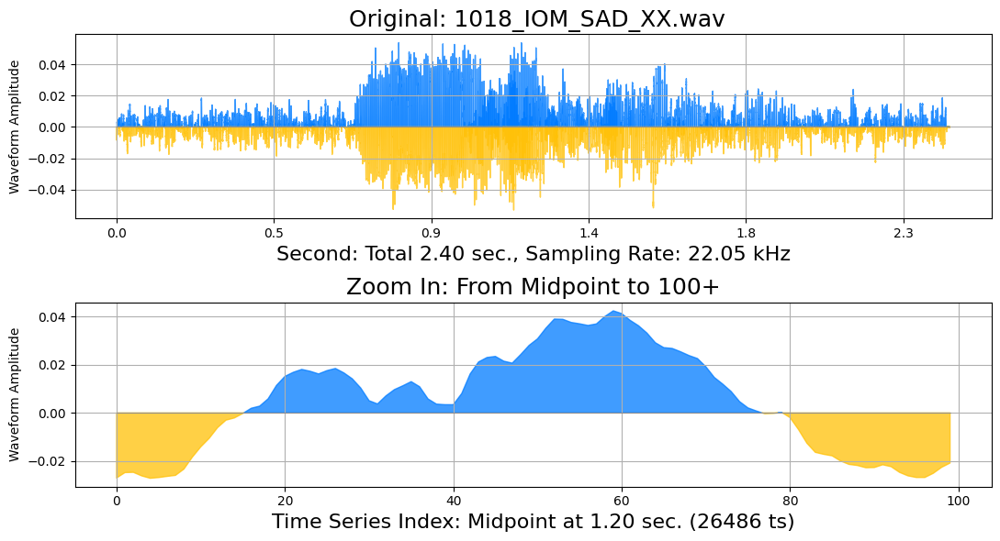

In [43]:
pluto.play_aug_pitch_scaling(pluto.df_voice_data,min_semitones=-6.0, max_semitones=6.0)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


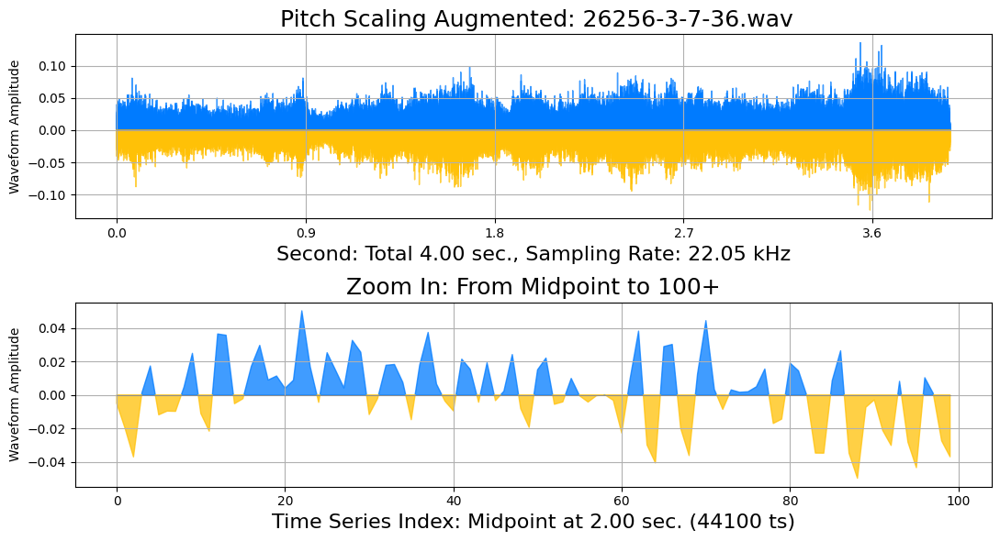

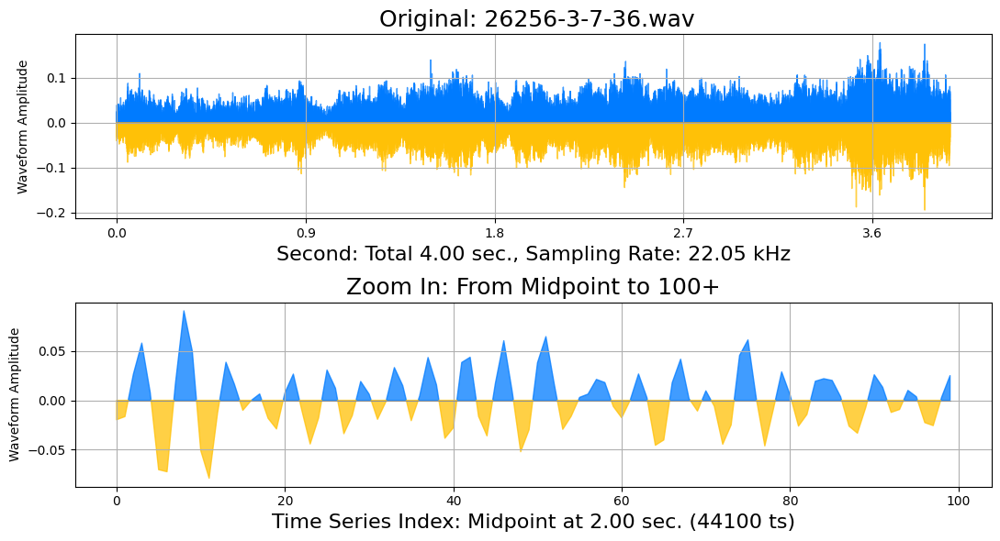

In [44]:
pluto.play_aug_pitch_scaling(pluto.df_sound_data,min_semitones=4.0, max_semitones=11.0)

# Noise injection, add Gaussian noise

In [45]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_noise_injection(self, df, min_amplitude=0.002,max_amplitude=0.2,title='Gaussian noise injection'):
  xtransform = audiomentations.AddGaussianNoise(
    min_amplitude = min_amplitude,
    max_amplitude = max_amplitude,
    p=1.0)
  self._audio_transform(df, xtransform, title=title)
  return

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


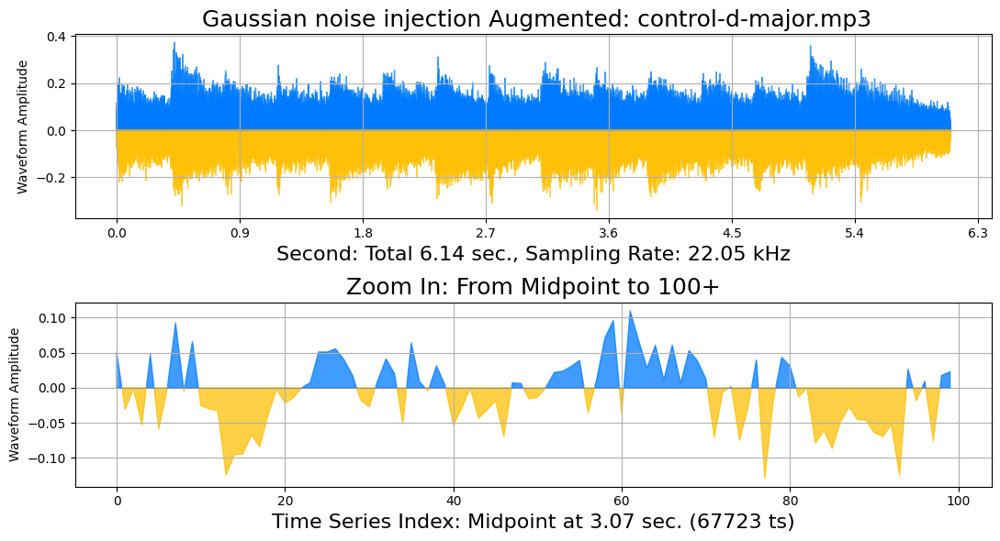

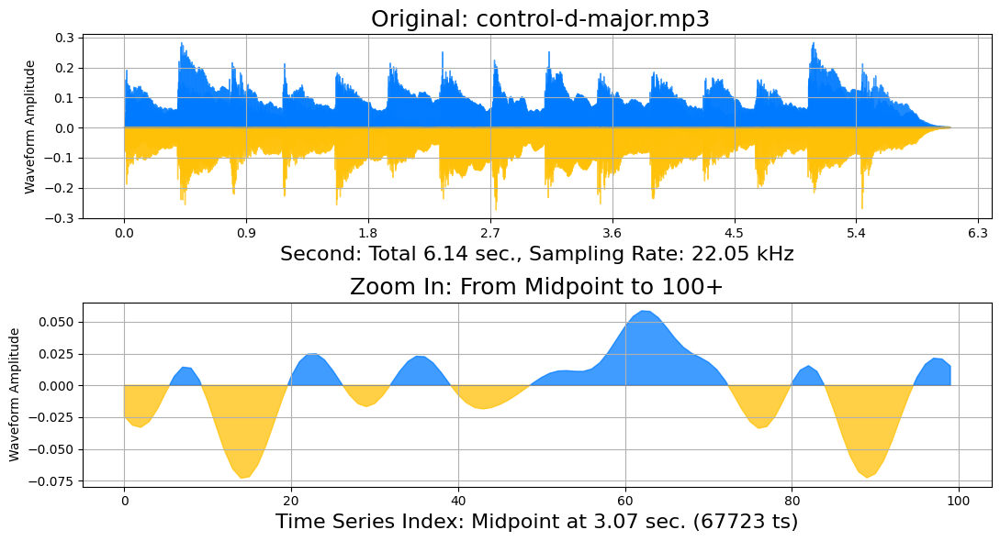

In [46]:
pluto.play_aug_noise_injection(pluto.audio_control_dmajor, min_amplitude=0.02,max_amplitude=0.05)

In [47]:
# pluto.fname_id

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


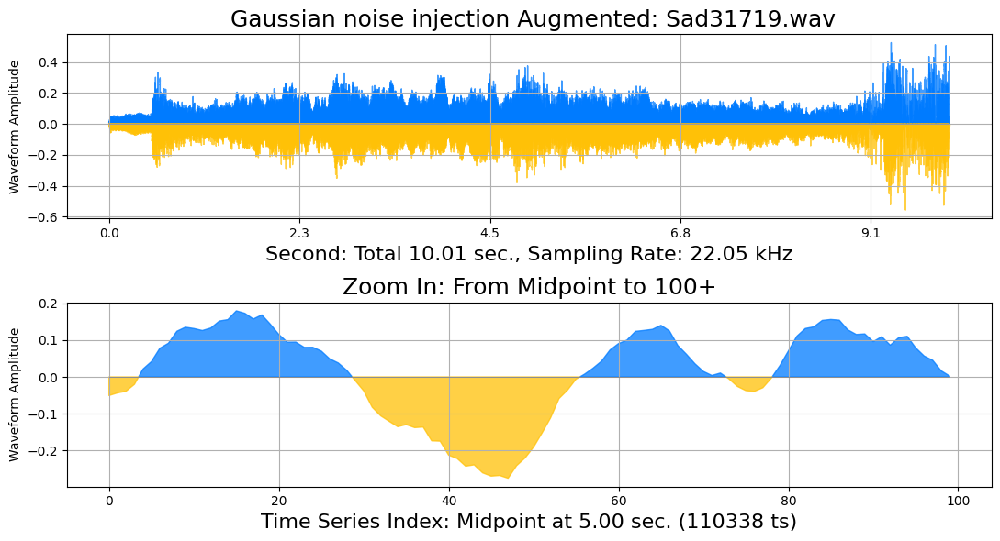

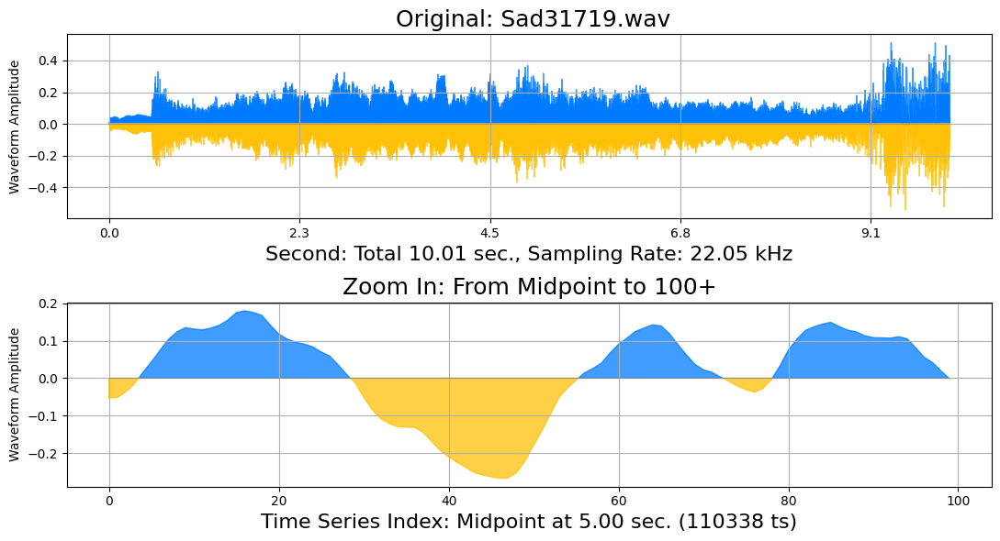

In [48]:
pluto.play_aug_noise_injection(pluto.df_music_data, max_amplitude=0.01)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


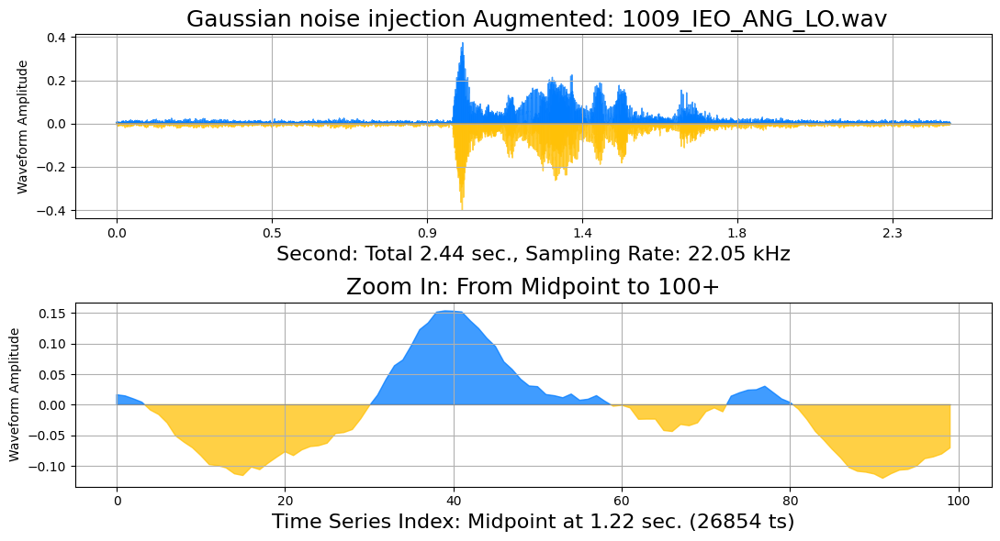

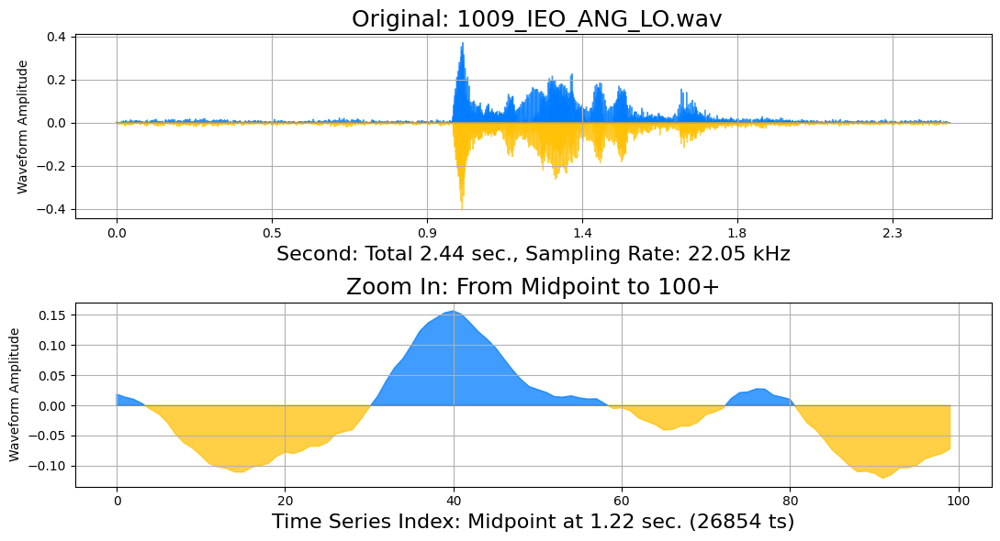

In [49]:
pluto.play_aug_noise_injection(pluto.df_voice_data, max_amplitude=0.01)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


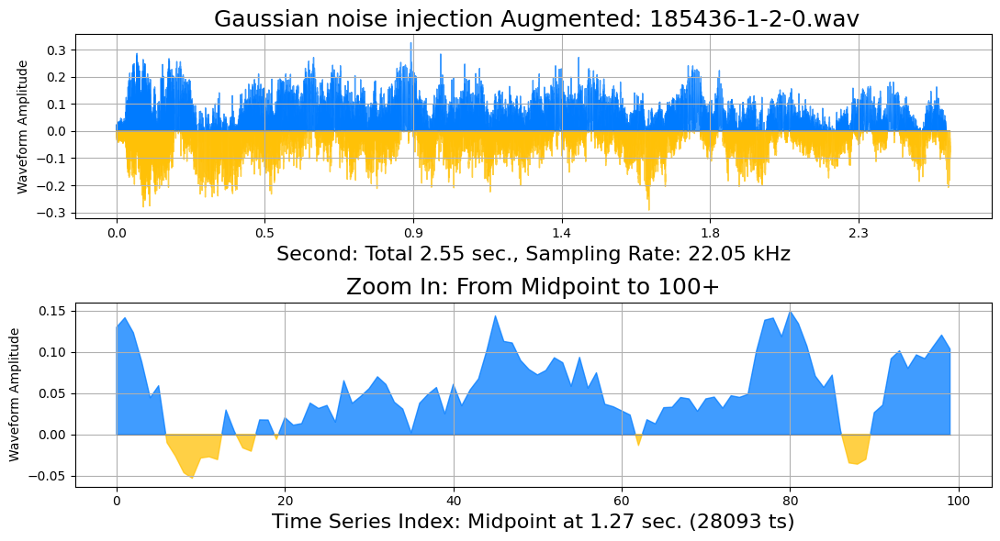

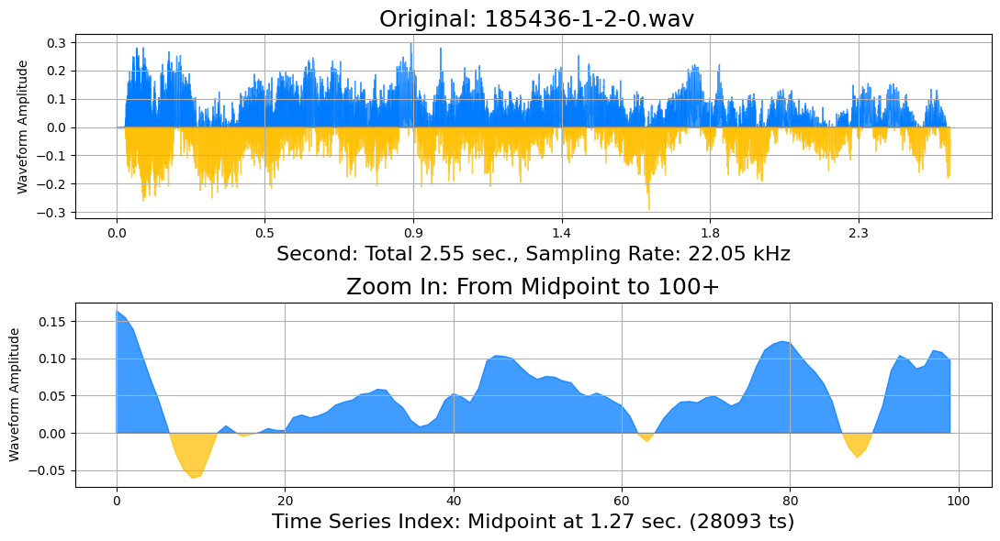

In [50]:
pluto.play_aug_noise_injection(pluto.df_sound_data, max_amplitude=0.022)

# Polarity Inversion

In [51]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_polar_inverse(self, df, title='Polarity inversion'):
  xtransform = audiomentations.PolarityInversion(
    p=1.0)
  self._audio_transform(df, xtransform, title=title)
  return

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


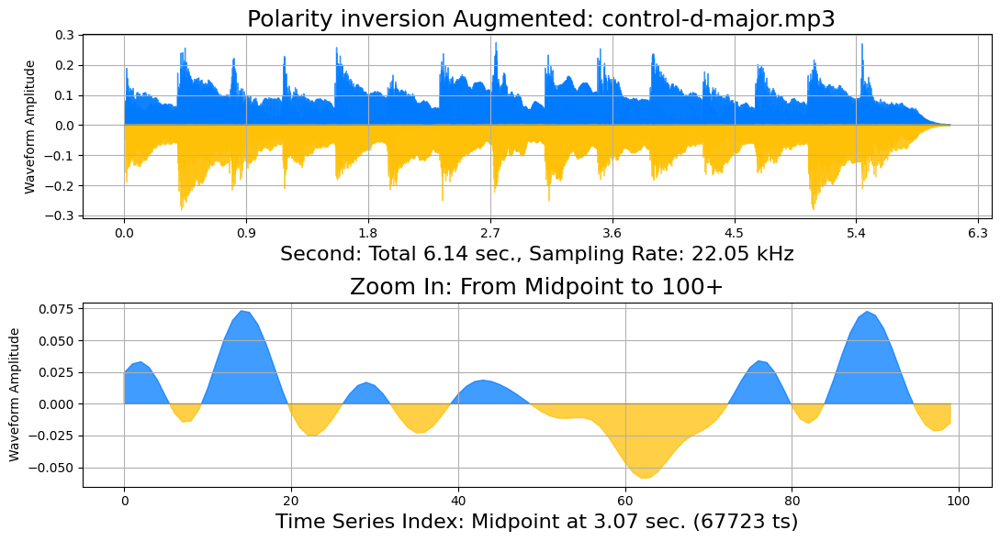

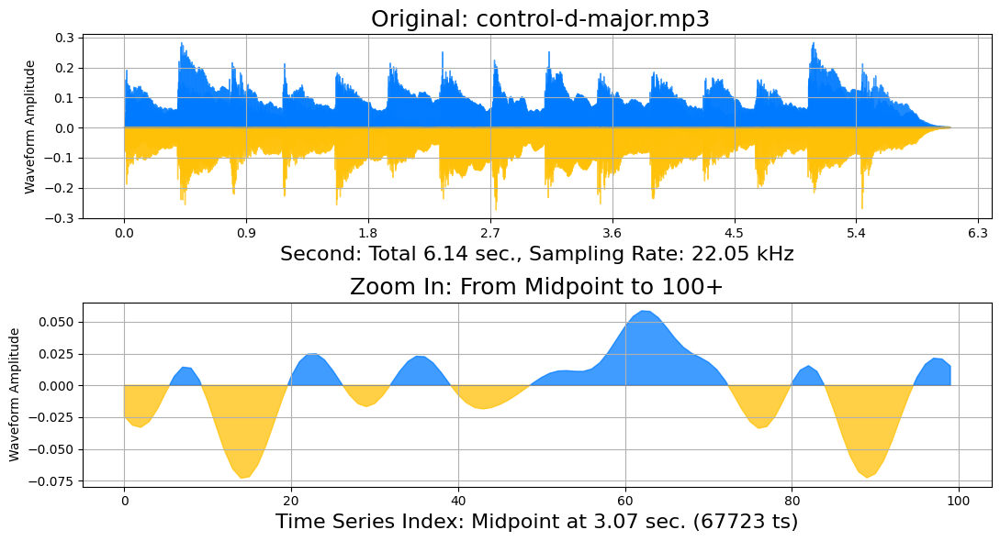

In [52]:
pluto.play_aug_polar_inverse(pluto.audio_control_dmajor)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


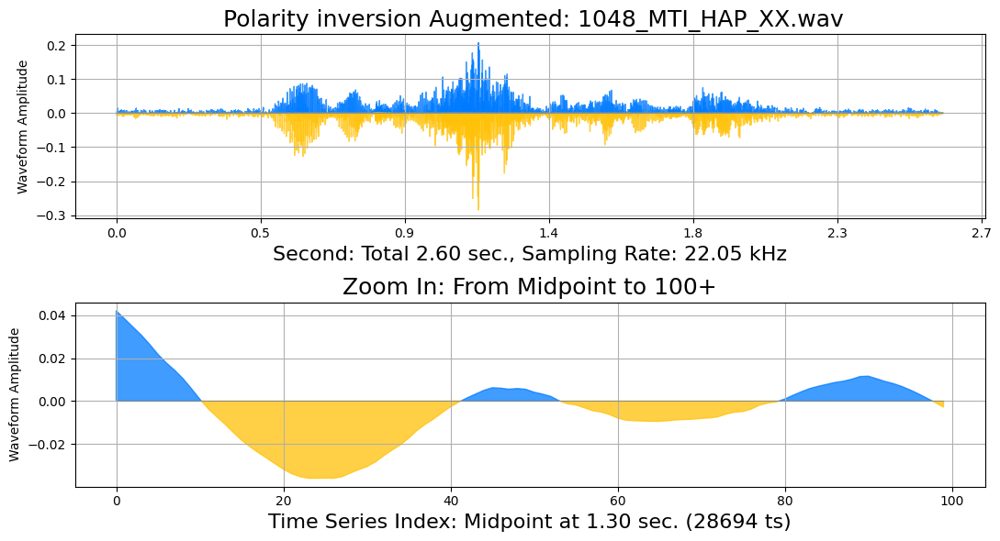

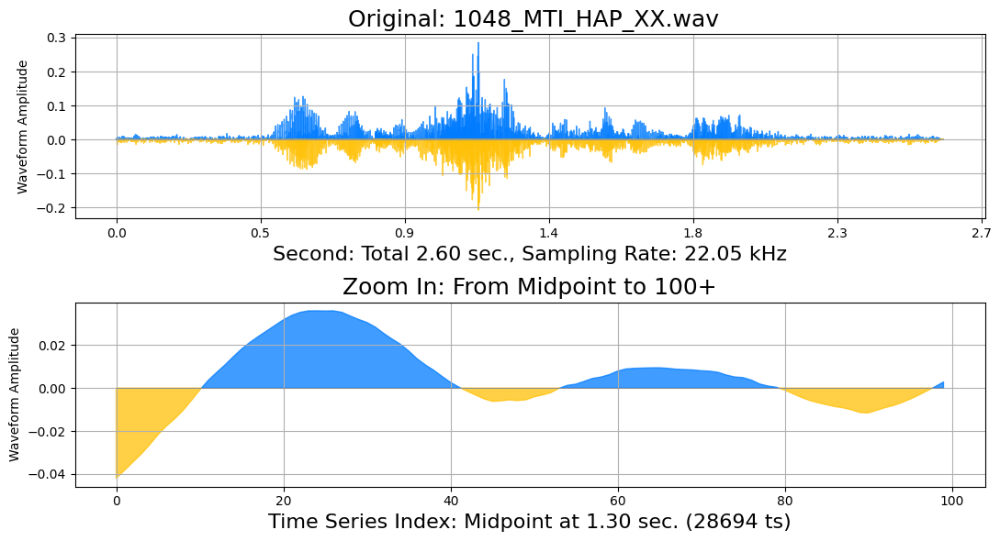

In [53]:
pluto.play_aug_polar_inverse(pluto.df_voice_data)

# Low pass Filter

In [54]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_low_pass_filter(self, df, 
  min_cutoff_freq=150, max_cutoff_freq=7500,
  min_rolloff=12, max_rolloff=24,
  title='Low pass filter'):
  xtransform = audiomentations.LowPassFilter(
    min_cutoff_freq = min_cutoff_freq,
    max_cutoff_freq = max_cutoff_freq,
    min_rolloff = min_rolloff,
    max_rolloff = max_rolloff,
    p=1.0)
  self._audio_transform(df, xtransform, title=title)
  return

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


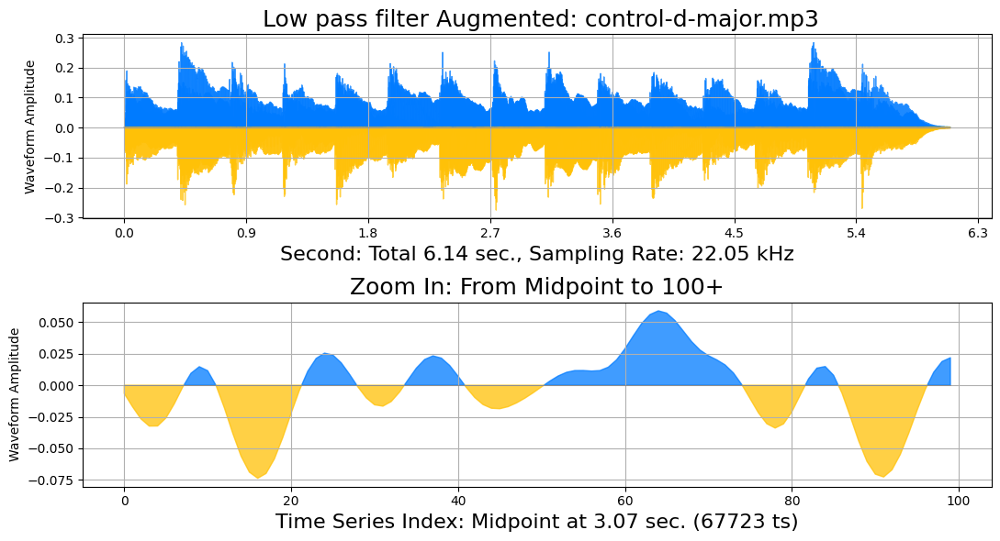

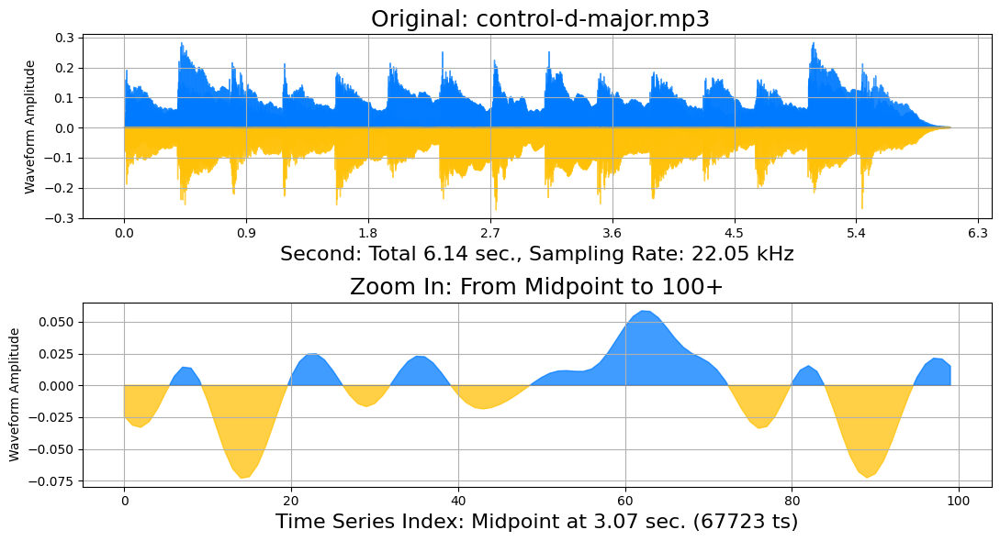

In [55]:
pluto.play_aug_low_pass_filter(pluto.audio_control_dmajor)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


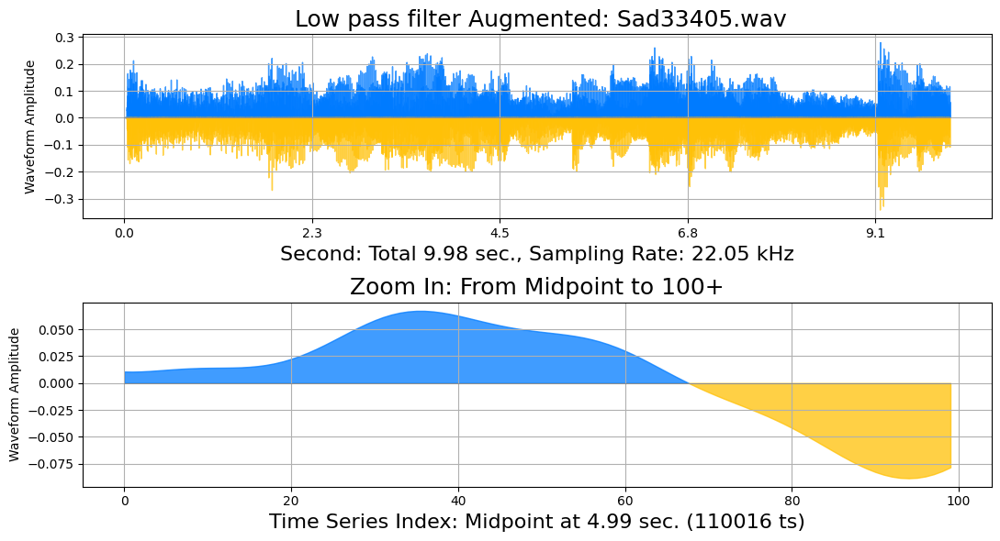

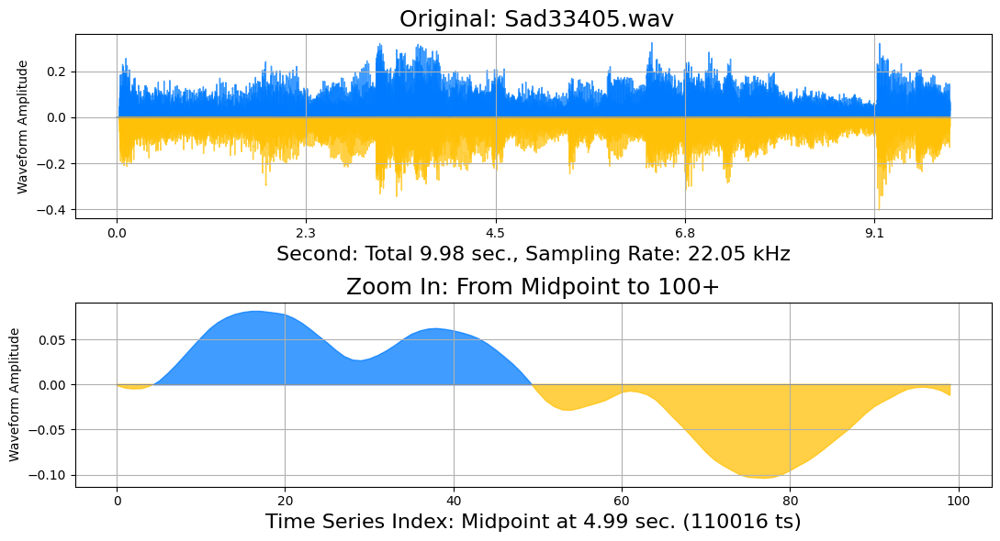

In [56]:
pluto.play_aug_low_pass_filter(pluto.df_music_data)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


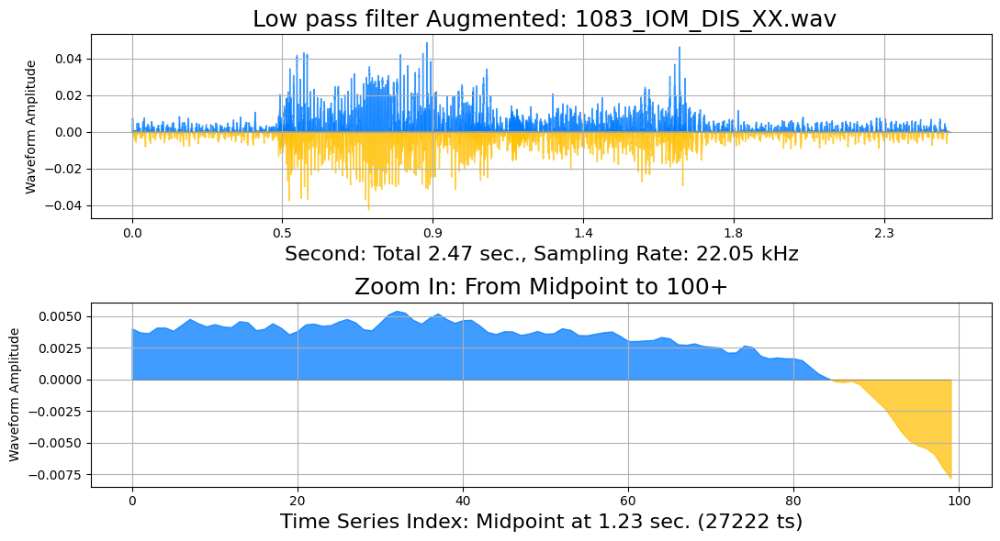

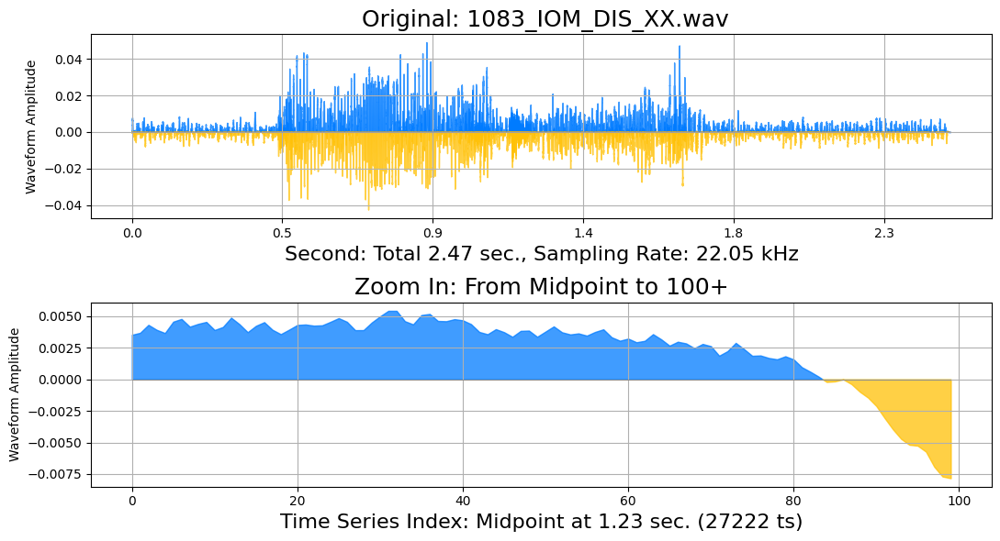

In [57]:
pluto.play_aug_low_pass_filter(pluto.df_voice_data)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


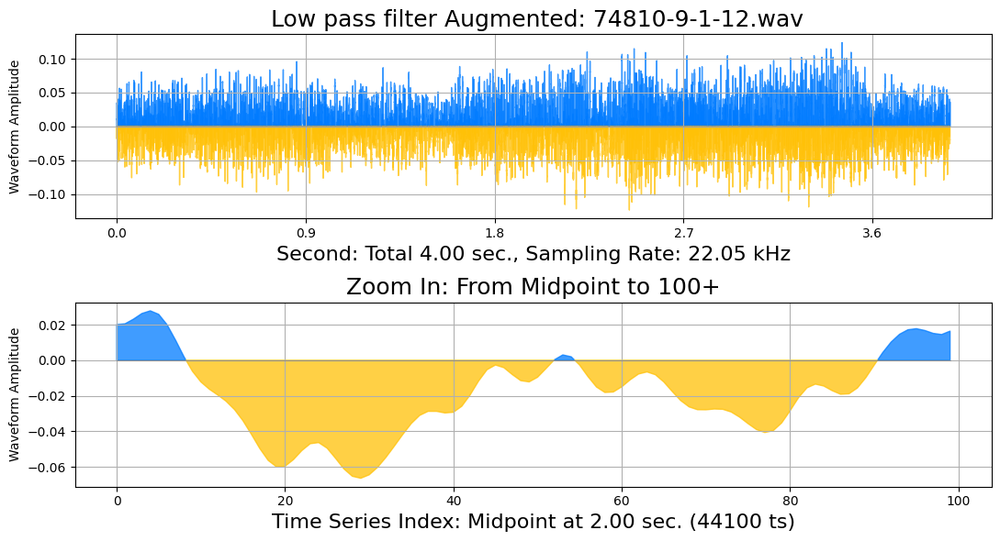

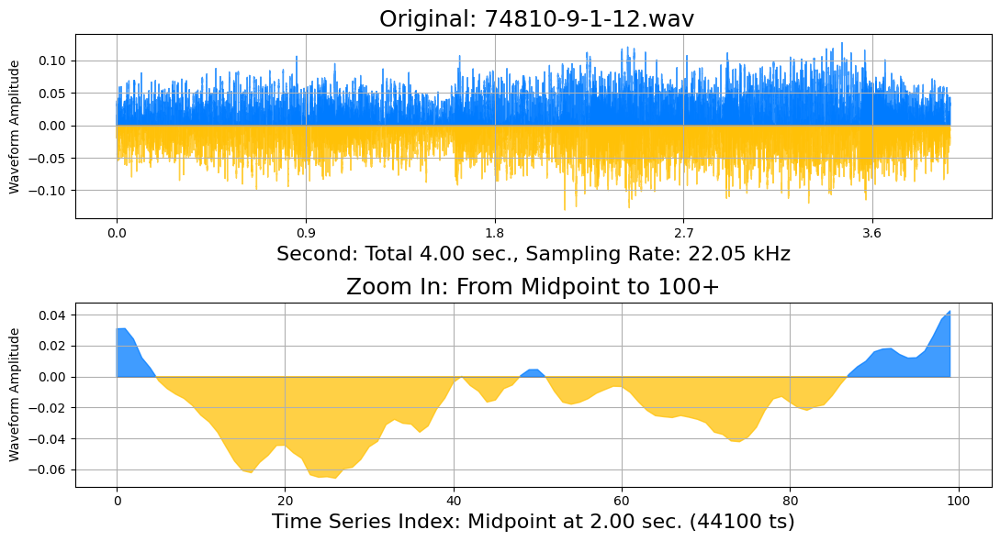

In [58]:
pluto.play_aug_low_pass_filter(pluto.df_sound_data)

#High pass filter

In [59]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_high_pass_filter(self, df, 
  min_cutoff_freq=20, max_cutoff_freq=2400,
  min_rolloff=12, max_rolloff=24,
  title='High pass filter'):
  xtransform = audiomentations.HighPassFilter(
    min_cutoff_freq = min_cutoff_freq,
    max_cutoff_freq = max_cutoff_freq,
    min_rolloff = min_rolloff,
    max_rolloff = max_rolloff,
    p=1.0)
  self._audio_transform(df, xtransform, title=title)
  return

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


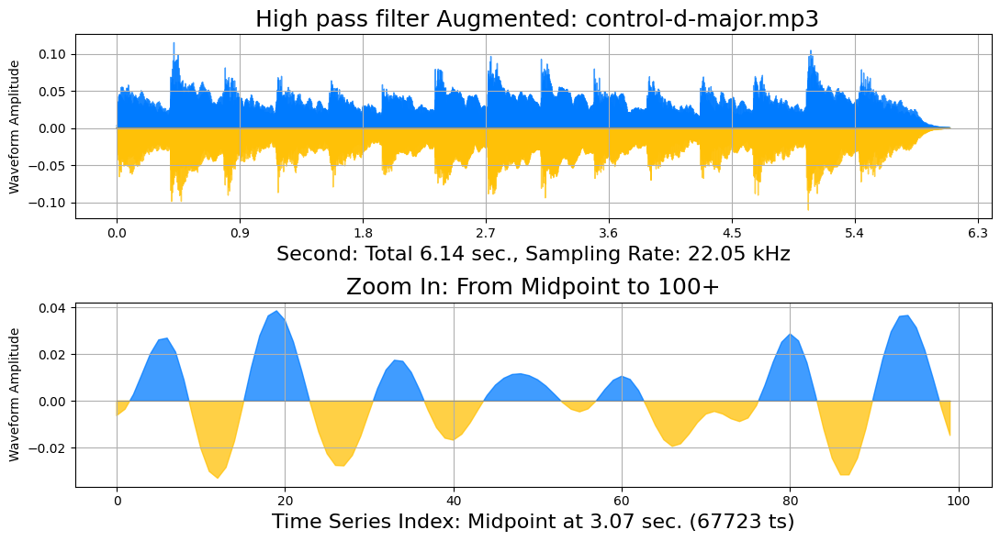

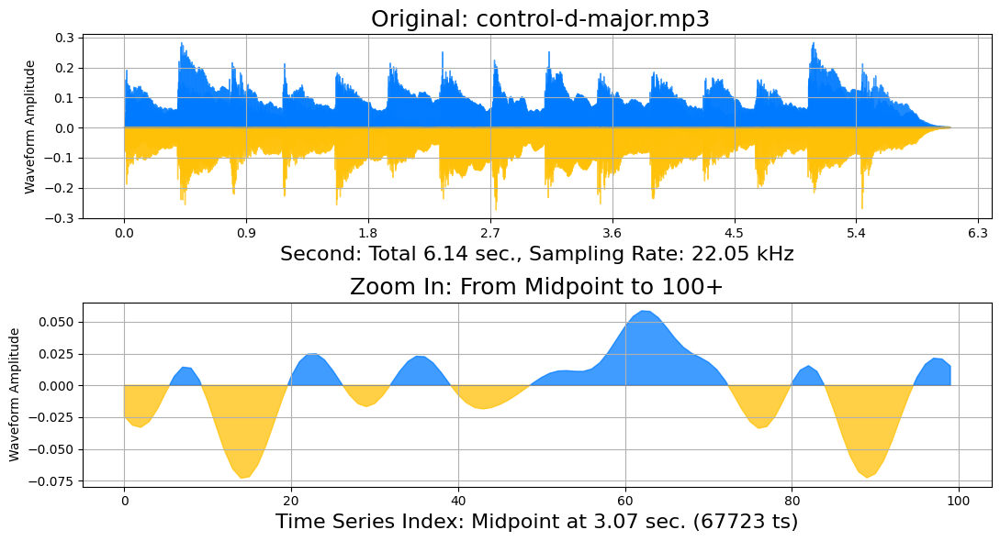

In [60]:
pluto.play_aug_high_pass_filter(pluto.audio_control_dmajor)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


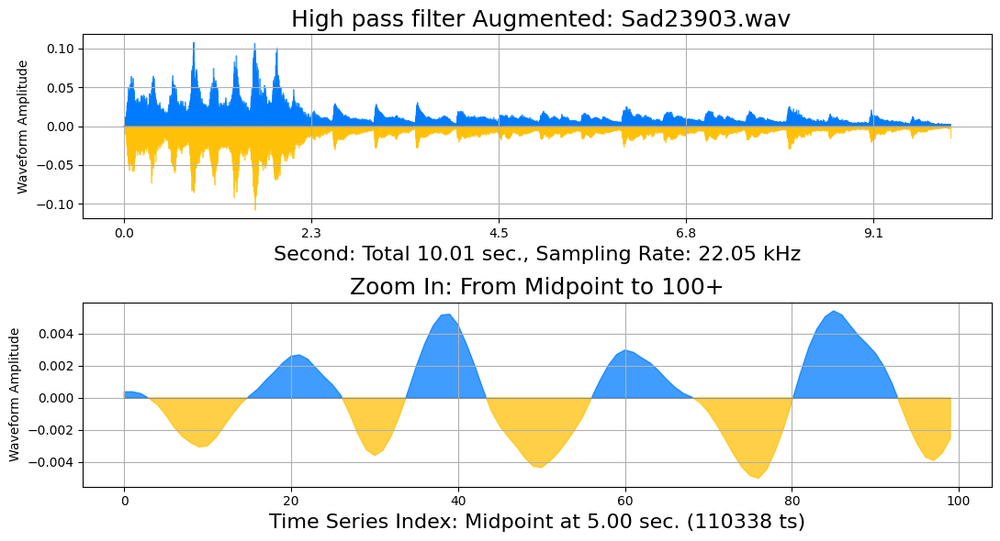

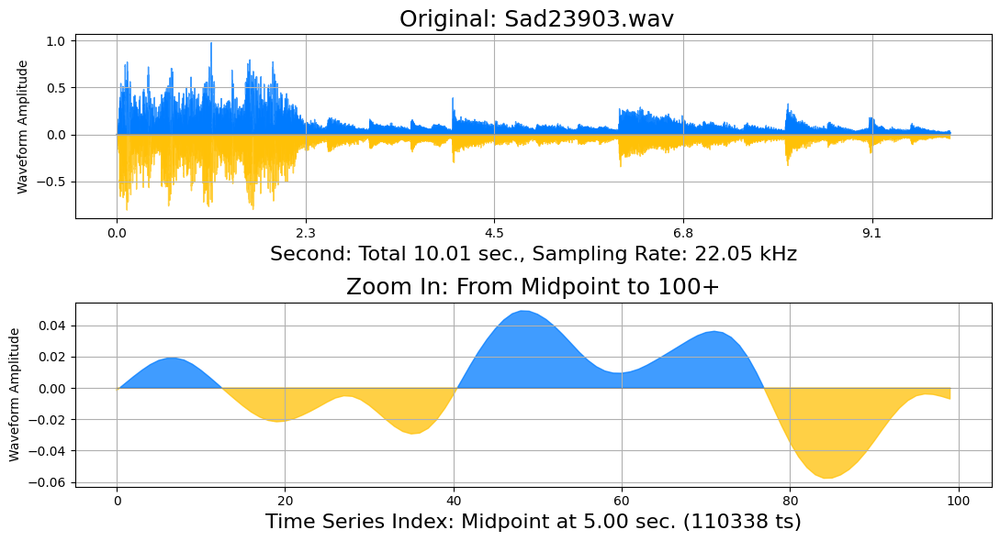

In [61]:
pluto.play_aug_high_pass_filter(pluto.df_music_data)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


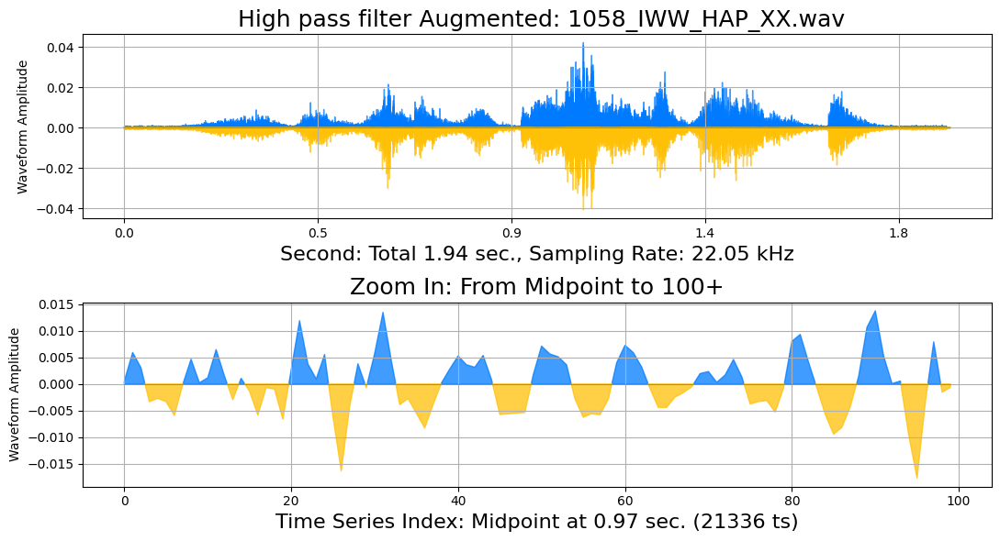

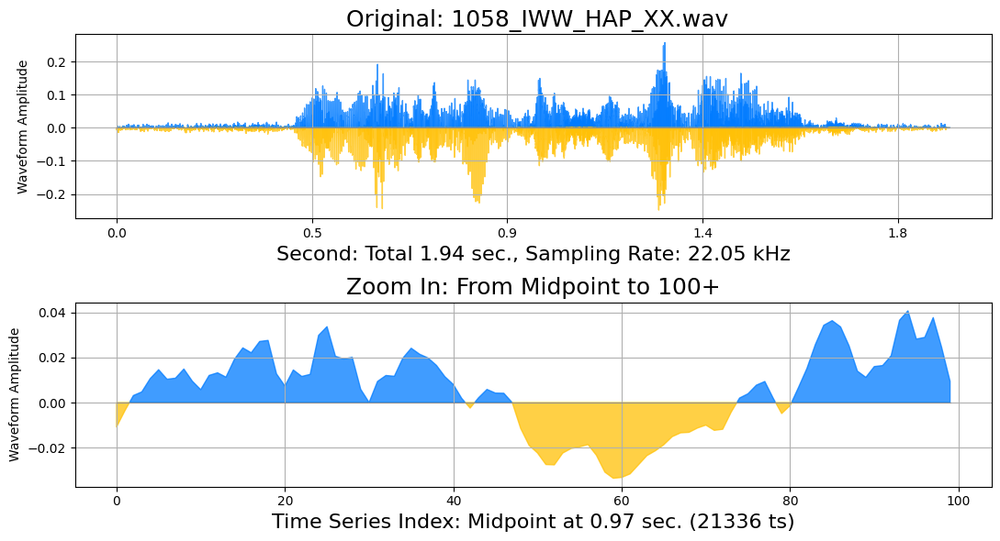

In [62]:
pluto.play_aug_high_pass_filter(pluto.df_voice_data)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


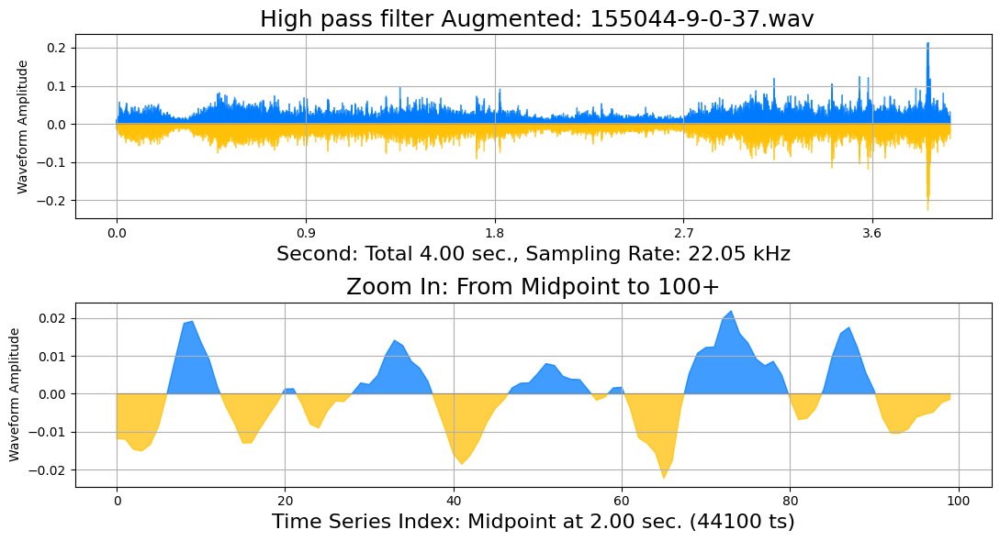

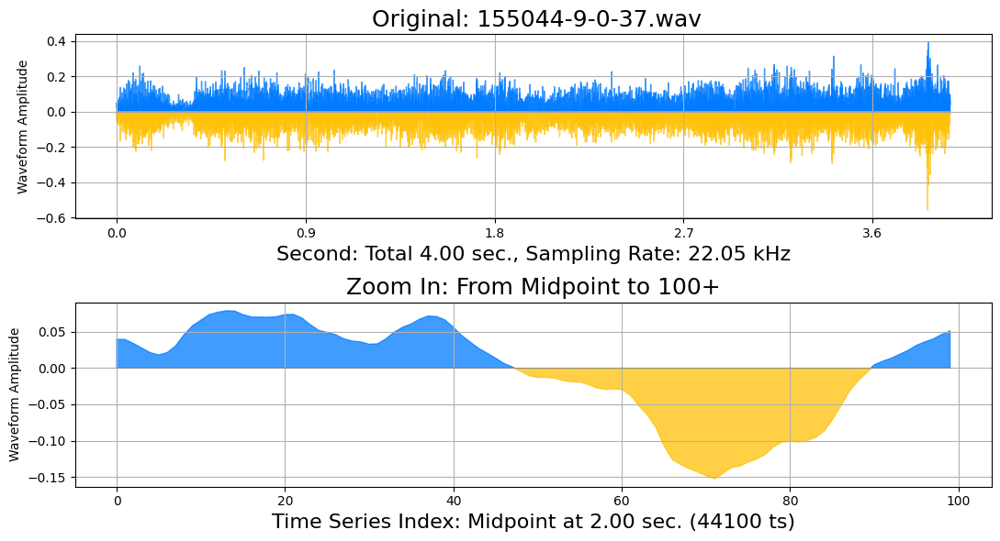

In [63]:
pluto.play_aug_high_pass_filter(pluto.df_sound_data)

# Band pass filter

In [64]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_band_pass_filter(self, df, 
  min_center_freq=200, max_center_freq=4000,
  min_bandwidth_fraction=0.5,max_bandwidth_fraction=1.99,
  min_rolloff=12, max_rolloff=24,
  title='Band pass filter'):
  xtransform = audiomentations.BandPassFilter(
    min_center_freq = min_center_freq,
    max_center_freq = max_center_freq,
    min_bandwidth_fraction = min_bandwidth_fraction,
    max_bandwidth_fraction = max_bandwidth_fraction,
    min_rolloff = min_rolloff,
    max_rolloff = max_rolloff,
    p=1.0)
  self._audio_transform(df, xtransform, title=title)
  return

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


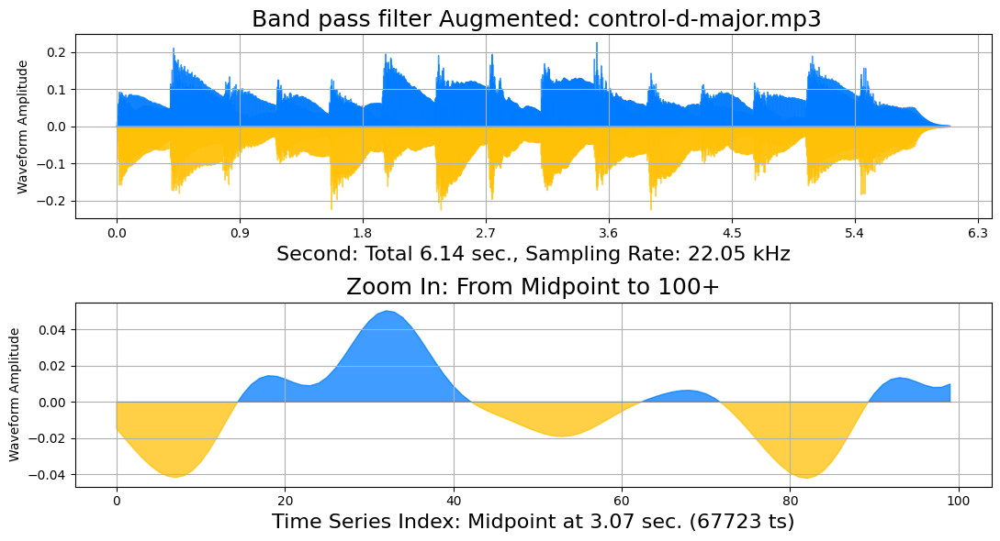

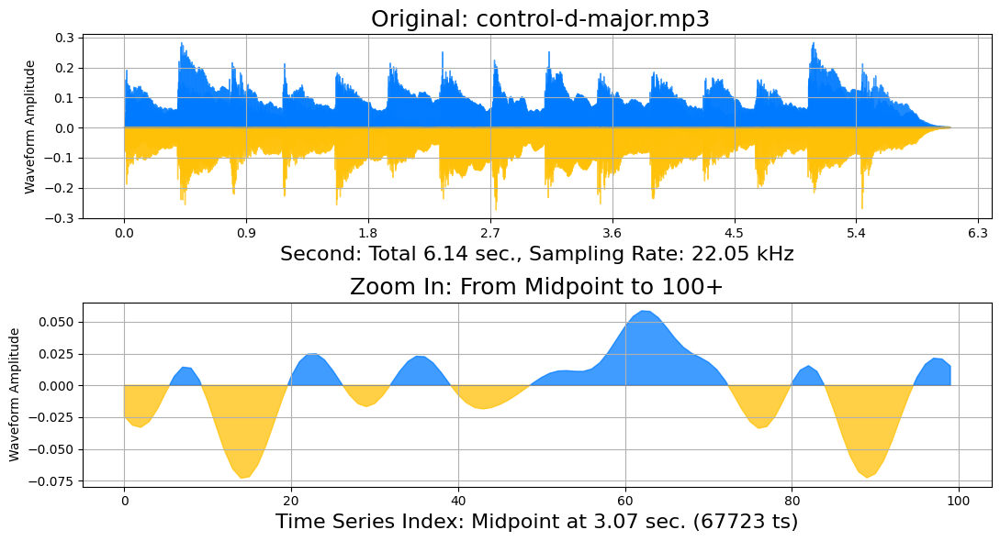

In [65]:
pluto.play_aug_band_pass_filter(pluto.audio_control_dmajor)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


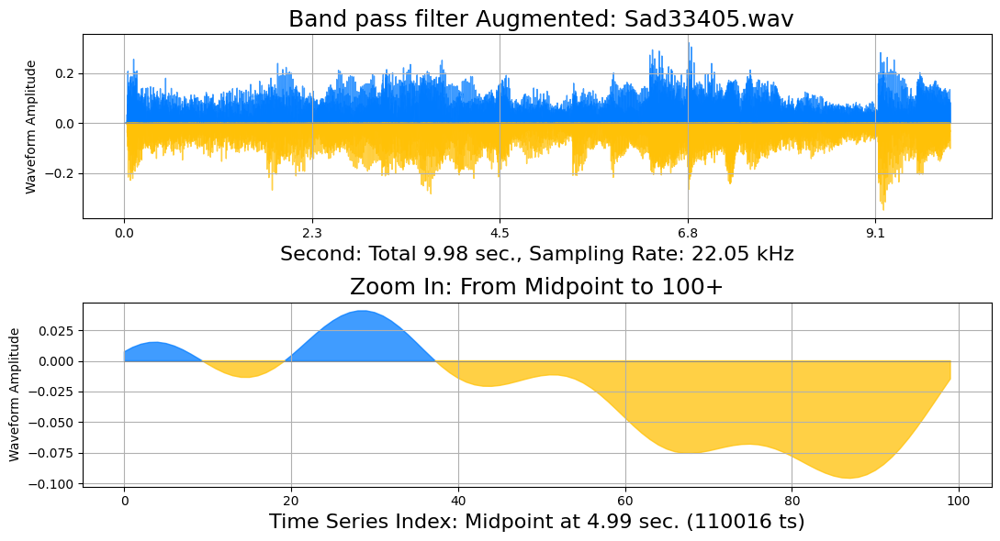

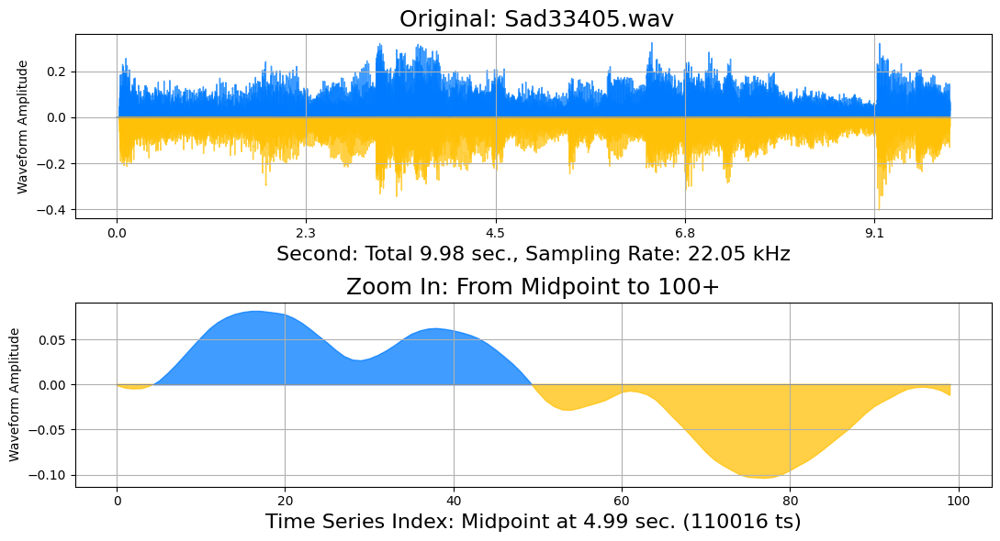

In [66]:
pluto.play_aug_band_pass_filter(pluto.df_music_data)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


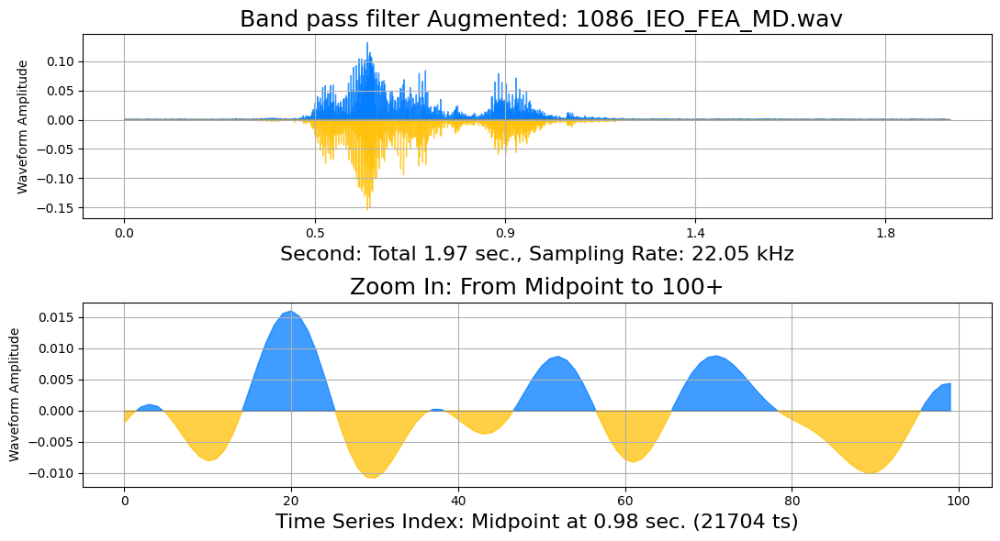

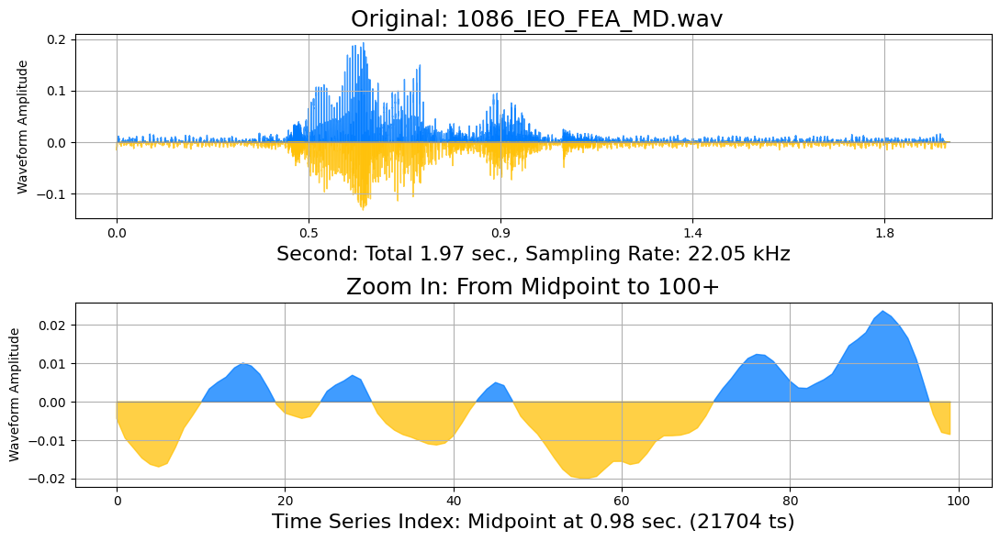

In [67]:
pluto.play_aug_band_pass_filter(pluto.df_voice_data)

<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


<ipython-input-20-425eb0af46c8>:61: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


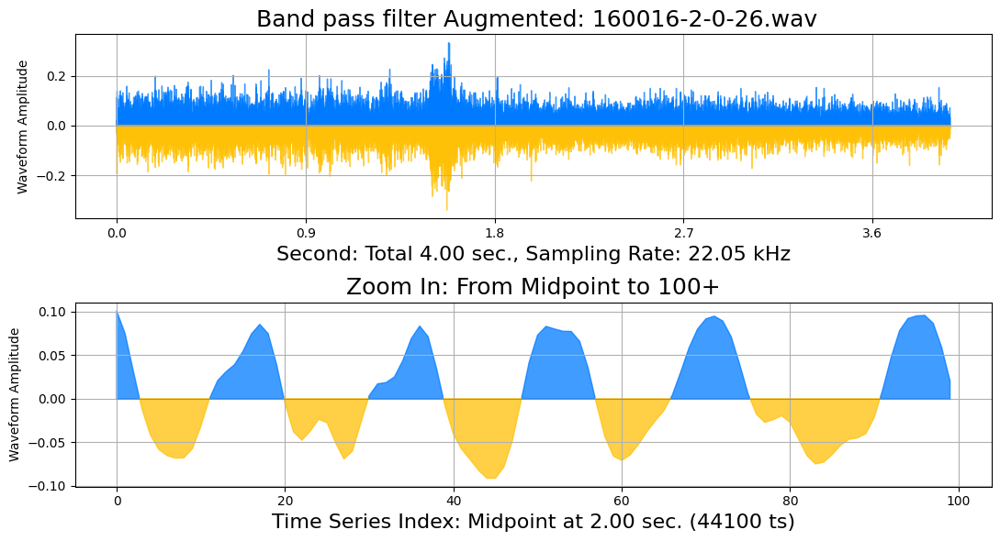

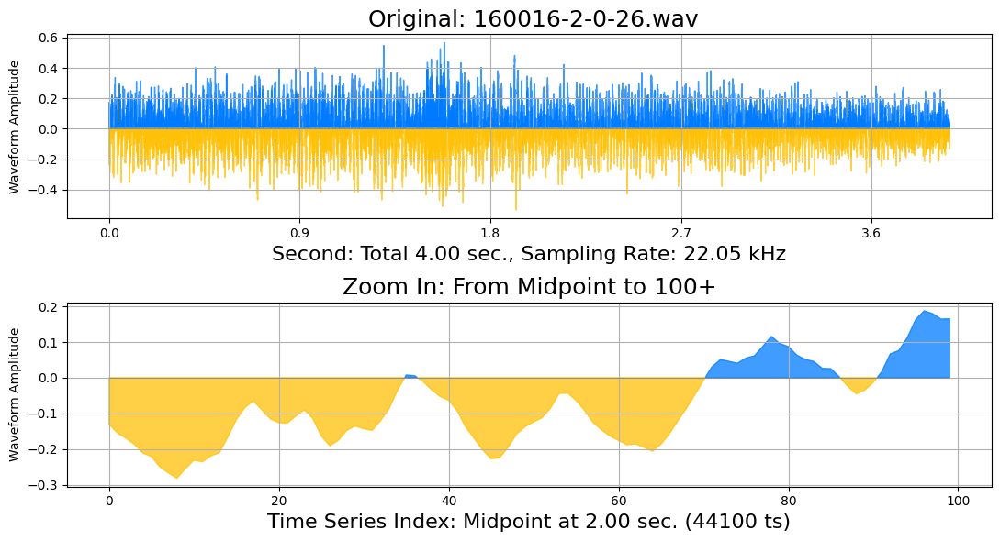

In [68]:
pluto.play_aug_band_pass_filter(pluto.df_sound_data)

# Sneak peek (Optional)

In [69]:
pluto.text_marry_lamb = 'Mary had a little lamb, whose fleece was white as snow. And everywhere that Mary went, the lamb was sure to go.'

In [70]:
x = numpy.array([ord(c) for c in pluto.text_marry_lamb])

In [71]:
k = pandas.DataFrame(x, columns=['tdata'])
k.head()

,tdata
0,77
1,97
2,114
3,121
4,32


In [72]:
pluto.fname_id=0

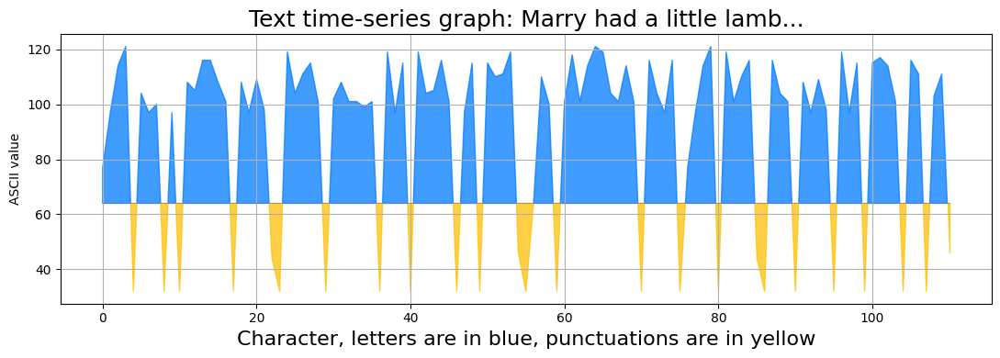

In [73]:
canvas, pic = matplotlib.pyplot.subplots(1, 1, figsize=(11, 4))
# pics = pic.flatten()
pluto._draw_area_with_neg(x,pic,izero=64)
pic.set_title('Text time-series graph: Marry had a little lamb...', fontsize=18.)
pic.set_xlabel('Character, letters are in blue, punctuations are in yellow', fontsize=16.)
pic.set_ylabel('ASCII value')
pic.grid()
# 
# display and save image
canvas.tight_layout()
pluto._drop_image(canvas)
canvas.show()

In [74]:
print('End of chapter 7')

End of chapter 7


# Push up all changes (Optional)

- username: duchaba

- password: [use the token]

In [ ]:
# import os
# f = 'Data-Augmentation-with-Python'
# os.chdir(f)
# !git add -A
# !git config --global user.email "duc.haba@gmail.com"
# !git config --global user.name "duchaba"
# !git commit -m "end of session"
# # do the git push in the xterm console
# #!git push

In [ ]:
# import google.colab
# import datetime
# @add_method(PacktDataAug)
# def zip_download(self,dname='/content/Data-Augmentation-with-Python/pluto_img'):
#   d = datetime.datetime.now()
#   d = d.strftime('%Y%m%d_')
#   fname = f'img{d}{self.fname_id}.zip'
#   !zip {fname} {dname}/*
#   google.colab.files.download(fname)
#   return
# #

In [ ]:
# pluto.zip_download()

# Summary 

Every chaper will begin with same base class "PacktDataAug".

✋ FAIR WARNING:

- The coding uses long and complete function path name.

- Pluto wrote the code for easy to understand and not for compactness, fast execution, nor cleaverness.

- Use Xterm to debug cloud server



In [ ]:
# !pip install colab-xterm
# %load_ext colabxterm
# %xterm